# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels,n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
# Check that the device of get_one_hot_labels matches the input device
if torch.cuda.is_available():
    assert str(get_one_hot_labels(torch.Tensor([[0]]).long().cuda(), 1).device).startswith("cuda")
    
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]))
if torch.cuda.is_available():
    # Check that it doesn't break with cuda
    cuda_check = combine_vectors(torch.tensor([[1, 2], [3, 4]]).cuda(), torch.tensor([[5, 6], [7, 8]]).cuda())
    assert str(cuda_check.device).startswith("cuda")
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
# Check that the float transformation doesn't happen after the inputs are concatenated
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12)).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.3207035393714905, discriminator loss: 0.2384451160170138


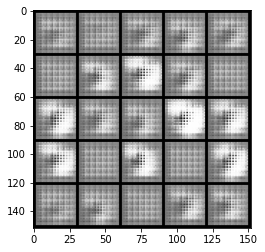

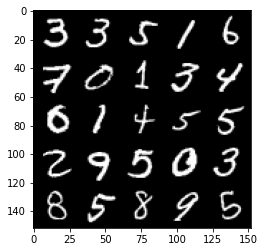

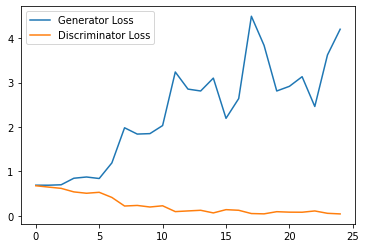

Step 1000: Generator loss: 4.482888679504395, discriminator loss: 0.0424873057063669


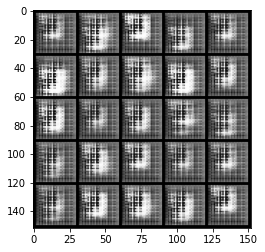

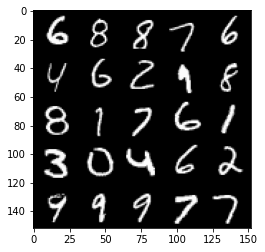

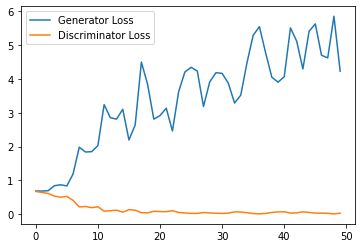

Step 1500: Generator loss: 5.2287934122085575, discriminator loss: 0.026287443835288287


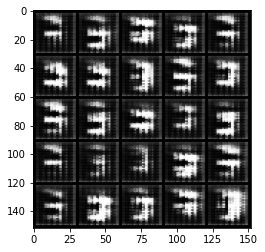

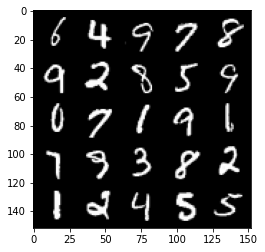

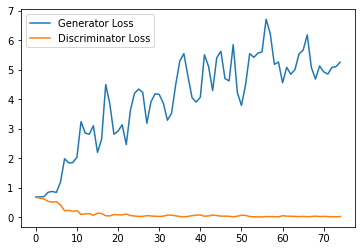

Step 2000: Generator loss: 4.84774617767334, discriminator loss: 0.04213401138409972


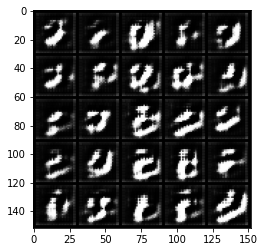

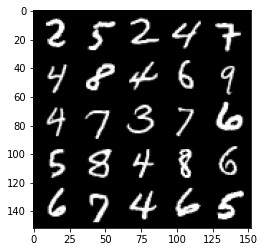

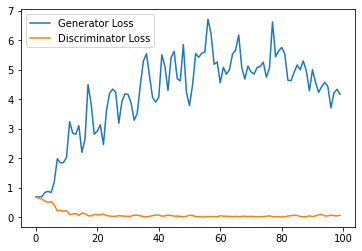

Step 2500: Generator loss: 3.7073940274715422, discriminator loss: 0.10448845741897822


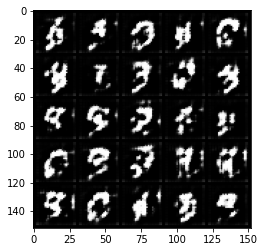

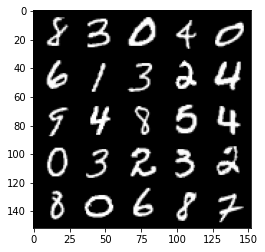

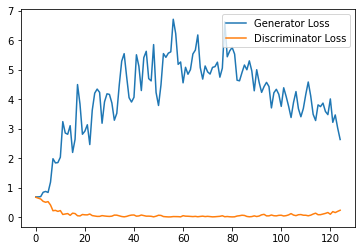

Step 3000: Generator loss: 2.794337448120117, discriminator loss: 0.23785521823167802


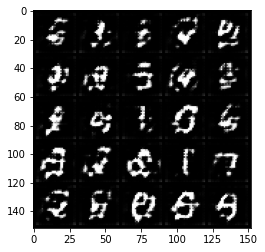

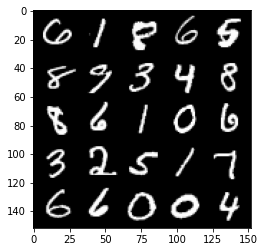

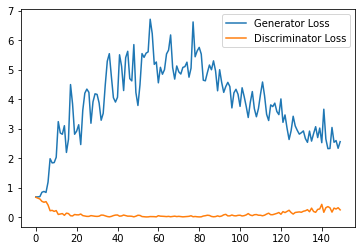

Step 3500: Generator loss: 2.423412047147751, discriminator loss: 0.24625704437494278


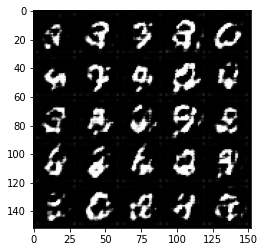

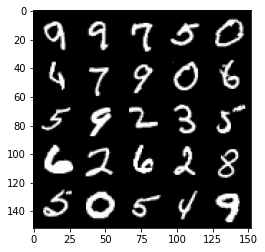

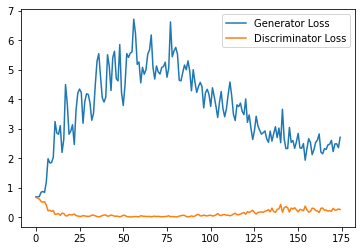

Step 4000: Generator loss: 2.3318163492679598, discriminator loss: 0.310079999178648


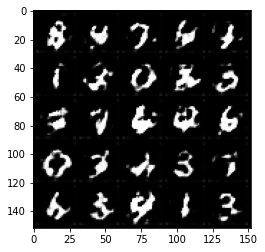

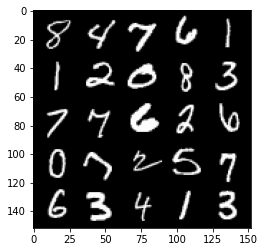

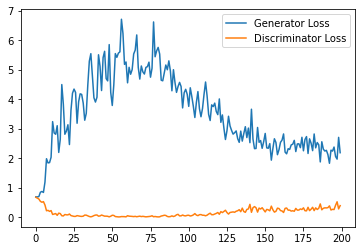

Step 4500: Generator loss: 1.9926023025512696, discriminator loss: 0.3492277438044548


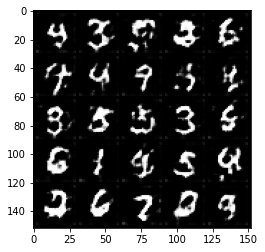

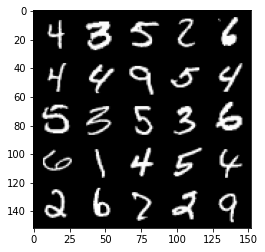

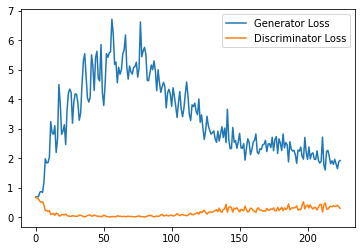

Step 5000: Generator loss: 1.8149294617176055, discriminator loss: 0.3694685383439064


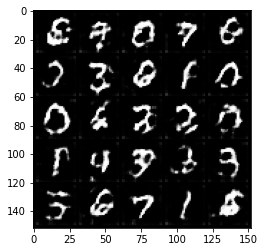

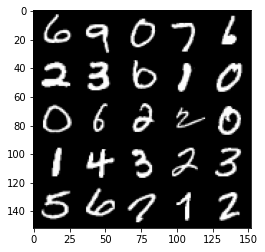

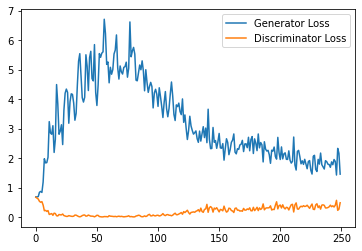

Step 5500: Generator loss: 1.7529877681732178, discriminator loss: 0.3793445858955383


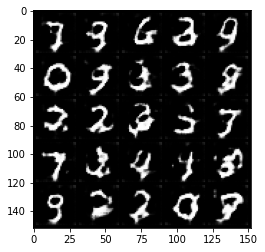

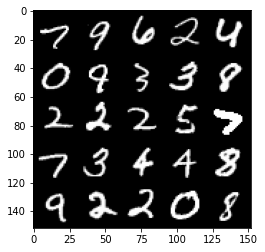

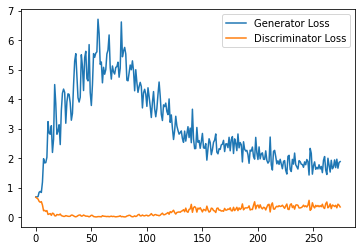

Step 6000: Generator loss: 1.8195573024749756, discriminator loss: 0.4157376403212547


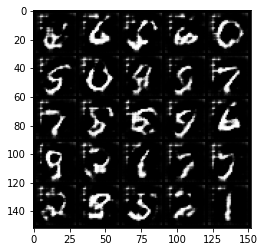

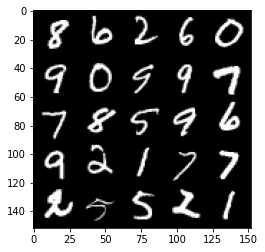

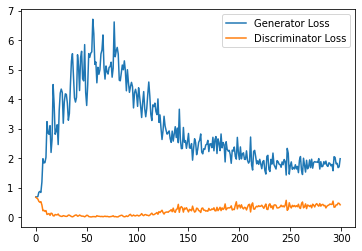

Step 6500: Generator loss: 1.6253799728155136, discriminator loss: 0.4249280269742012


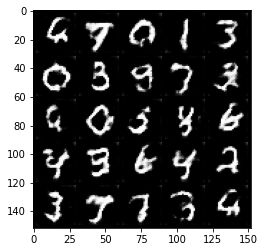

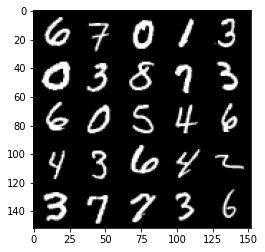

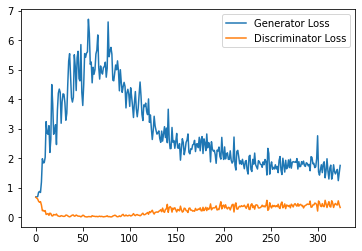

Step 7000: Generator loss: 1.499434867978096, discriminator loss: 0.45748983123898507


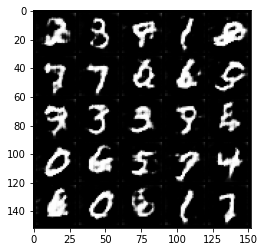

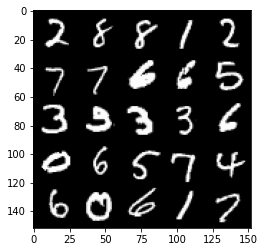

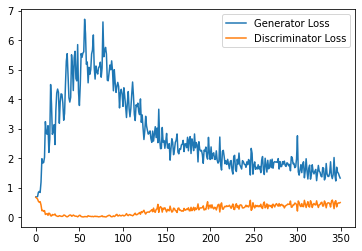

Step 7500: Generator loss: 1.4786961814165116, discriminator loss: 0.481423623919487


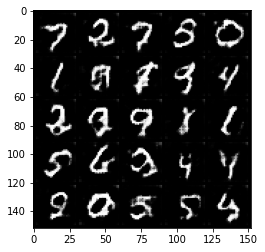

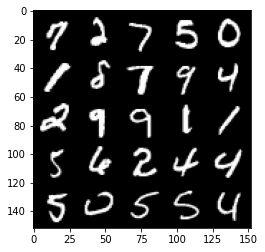

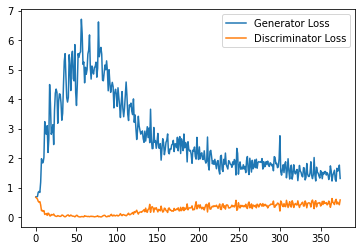

Step 8000: Generator loss: 1.4340800577402115, discriminator loss: 0.5015174479484558


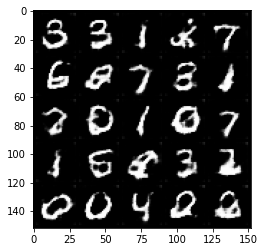

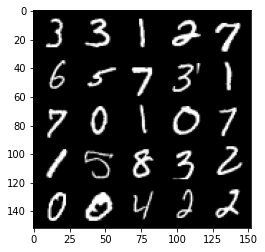

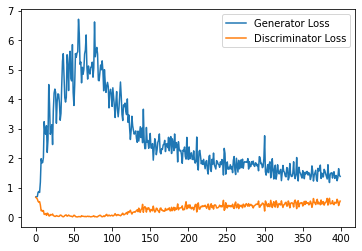

Step 8500: Generator loss: 1.3683801432847977, discriminator loss: 0.5127250601649285


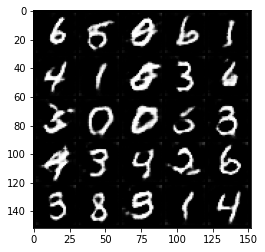

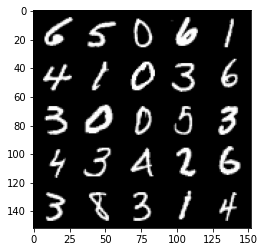

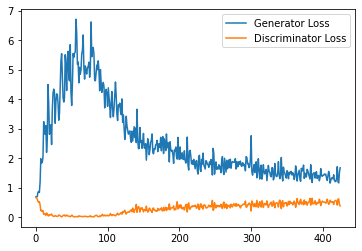

Step 9000: Generator loss: 1.262157772421837, discriminator loss: 0.5359098518490791


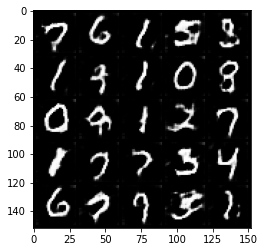

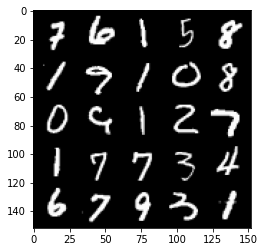

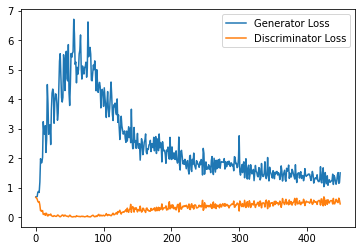

Step 9500: Generator loss: 1.293400406718254, discriminator loss: 0.537493596315384


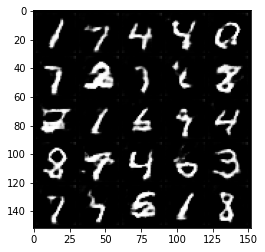

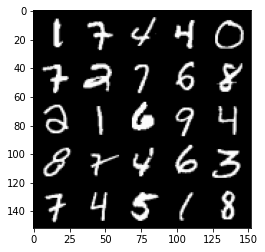

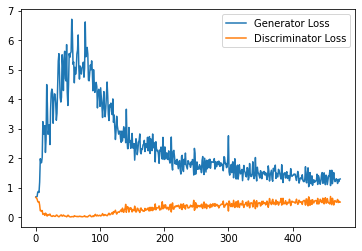

Step 10000: Generator loss: 1.2379841649532317, discriminator loss: 0.5450549448728561


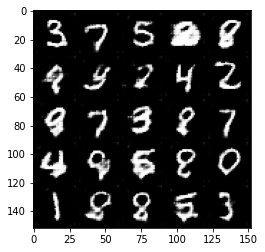

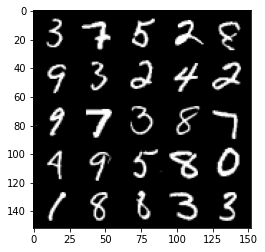

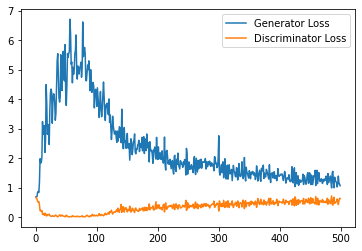

Step 10500: Generator loss: 1.2010288710594177, discriminator loss: 0.553756562948227


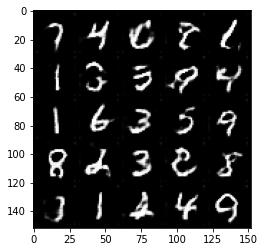

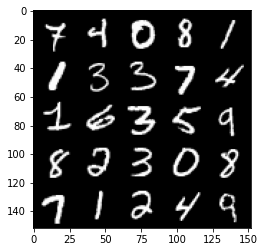

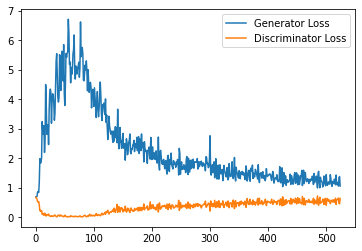

Step 11000: Generator loss: 1.2324789760112762, discriminator loss: 0.5566445348858833


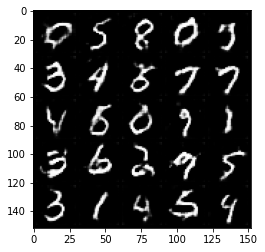

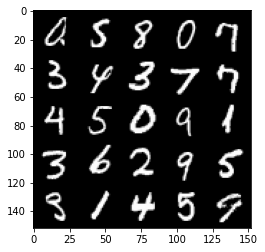

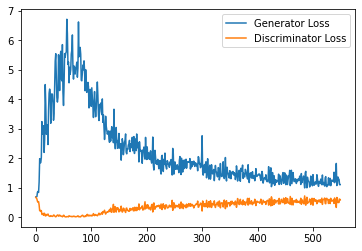

Step 11500: Generator loss: 1.140054068684578, discriminator loss: 0.5634743338823318


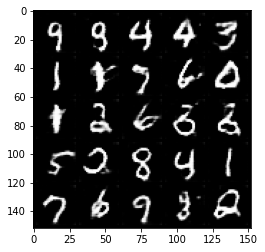

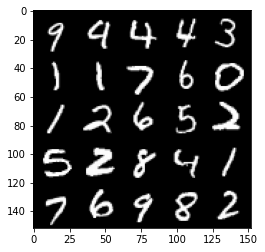

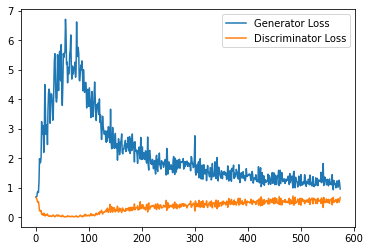

Step 12000: Generator loss: 1.1514040607213973, discriminator loss: 0.5651244685649872


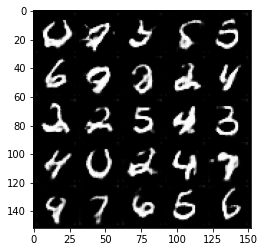

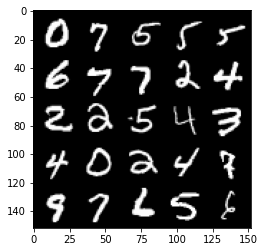

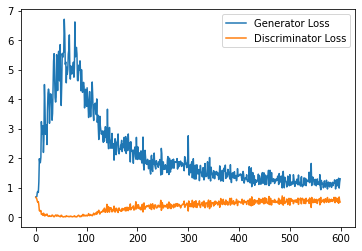

Step 12500: Generator loss: 1.143330666780472, discriminator loss: 0.5724579372406006


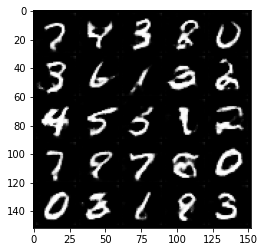

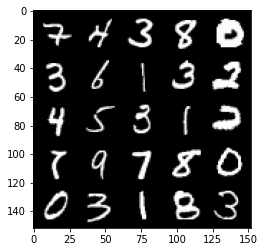

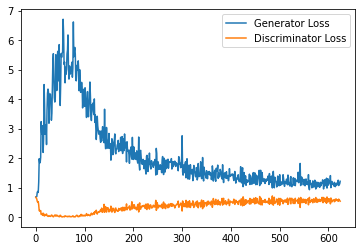

Step 13000: Generator loss: 1.0860711117982864, discriminator loss: 0.5741216444969177


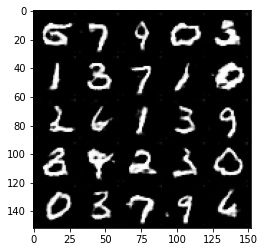

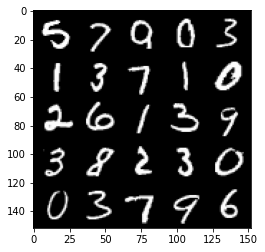

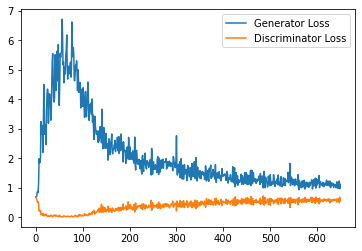

Step 13500: Generator loss: 1.0776738393306733, discriminator loss: 0.5868720103502274


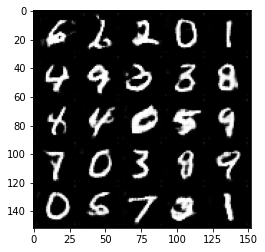

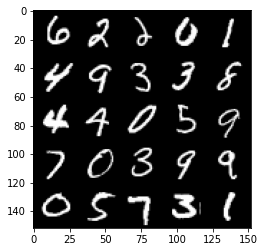

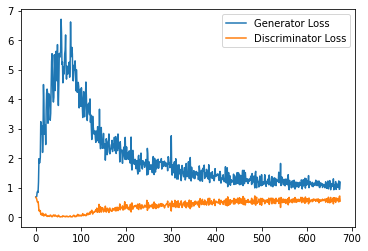

Step 14000: Generator loss: 1.1155385057926177, discriminator loss: 0.5845642713308334


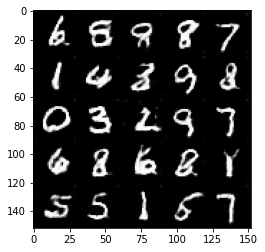

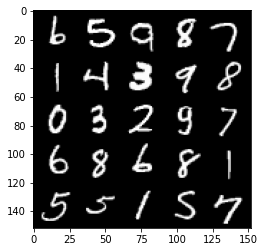

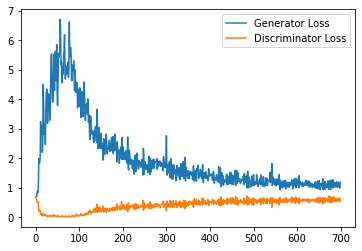

Step 14500: Generator loss: 1.0833635872602463, discriminator loss: 0.5904061124920845


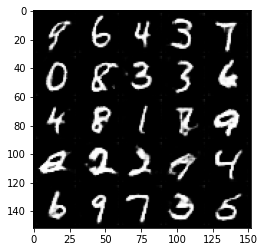

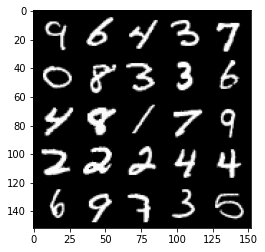

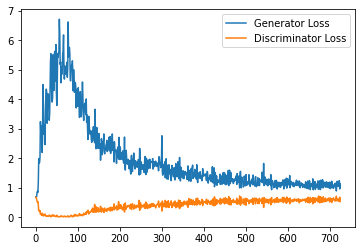

Step 15000: Generator loss: 1.0448796401023865, discriminator loss: 0.5991877727508544


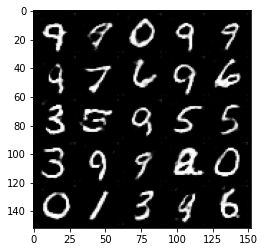

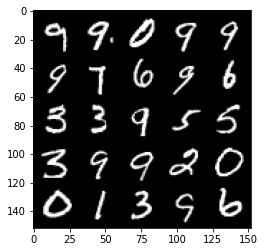

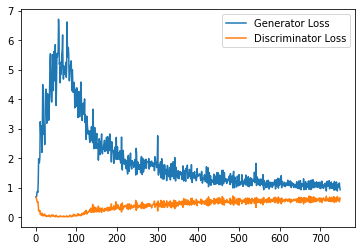

Step 15500: Generator loss: 1.0339193569421767, discriminator loss: 0.5993310549259185


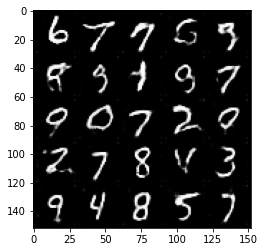

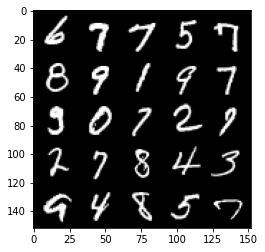

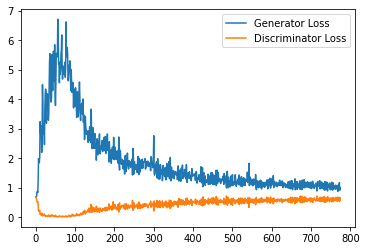

Step 16000: Generator loss: 1.0424613976478576, discriminator loss: 0.6046998805999756


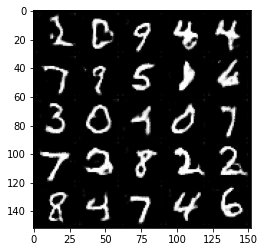

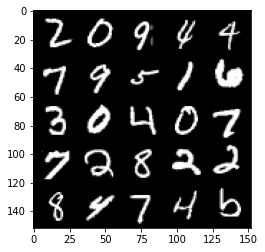

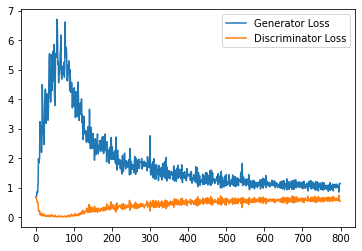

Step 16500: Generator loss: 1.0527276377677917, discriminator loss: 0.6061933441758156


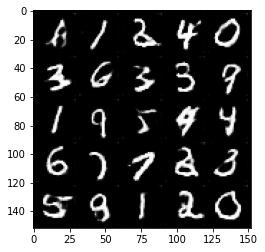

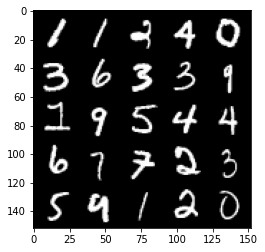

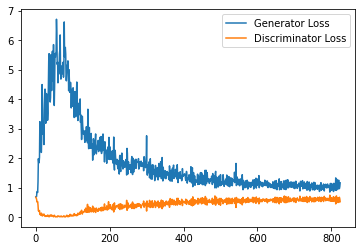

Step 17000: Generator loss: 1.0275568550825118, discriminator loss: 0.6089422789812088


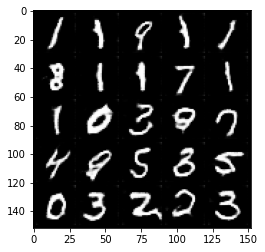

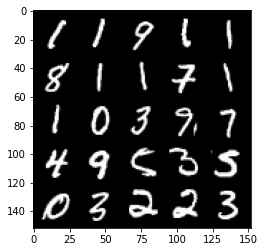

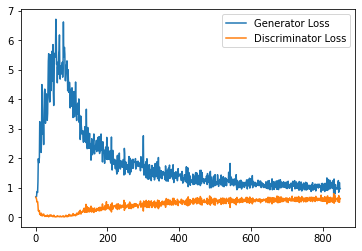

Step 17500: Generator loss: 1.0216539478302002, discriminator loss: 0.5994514713287353


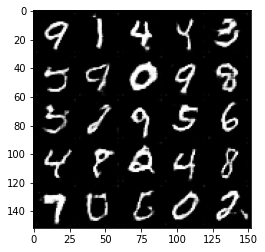

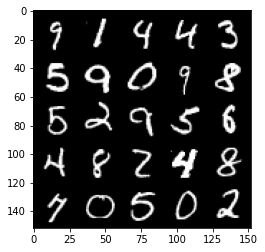

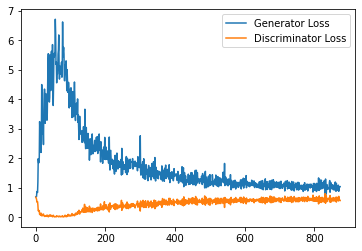

Step 18000: Generator loss: 1.0251936730146407, discriminator loss: 0.6089467136263848


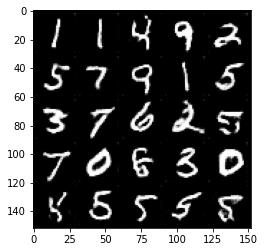

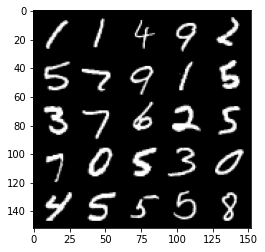

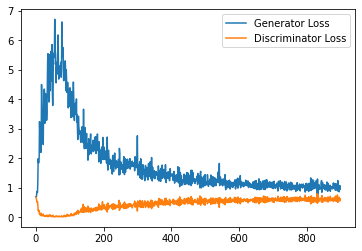

Step 18500: Generator loss: 0.9842214201688766, discriminator loss: 0.6028433495759964


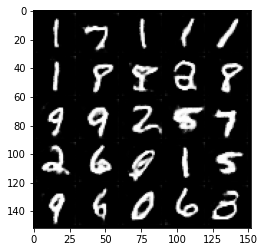

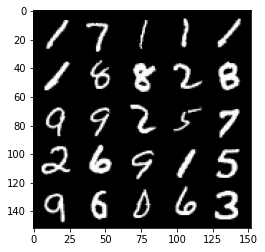

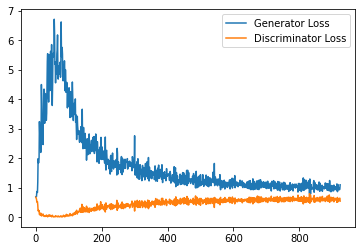

Step 19000: Generator loss: 0.9985542293787003, discriminator loss: 0.5959702741503715


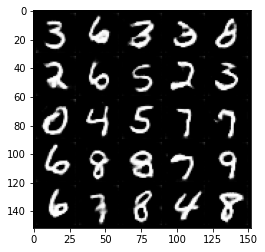

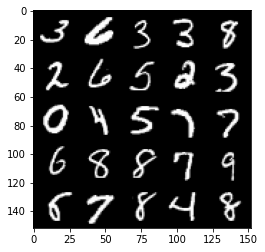

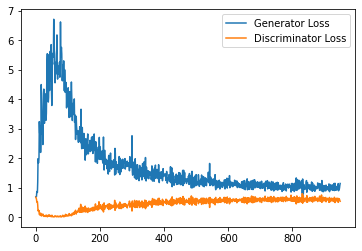

Step 19500: Generator loss: 0.9946165634393692, discriminator loss: 0.6017223210930824


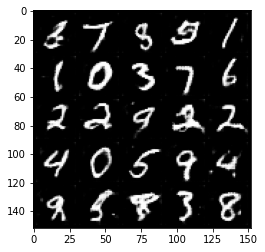

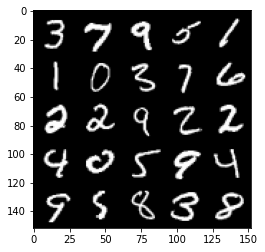

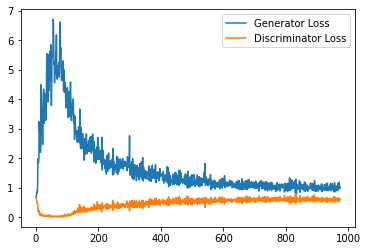

Step 20000: Generator loss: 0.9956973745822907, discriminator loss: 0.599170814037323


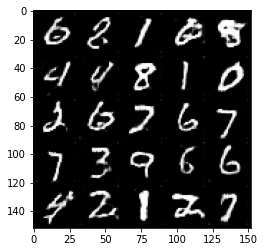

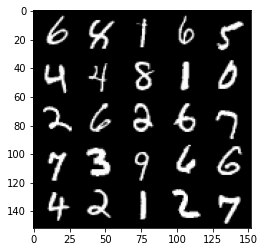

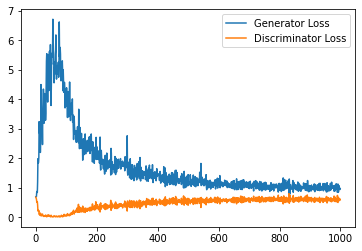

Step 20500: Generator loss: 0.9931145983934403, discriminator loss: 0.5964967668056488


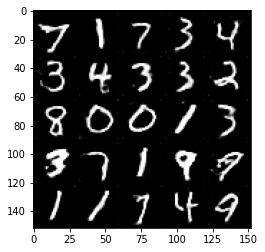

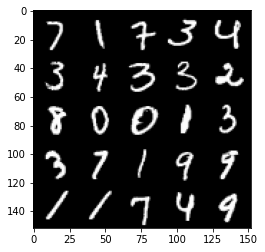

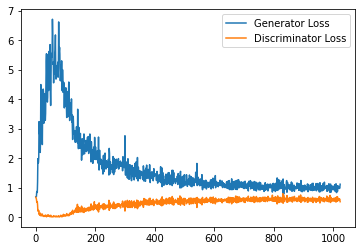

Step 21000: Generator loss: 1.018686423420906, discriminator loss: 0.600818532705307


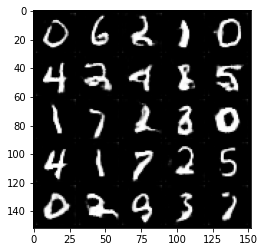

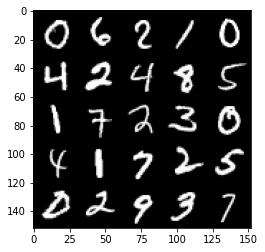

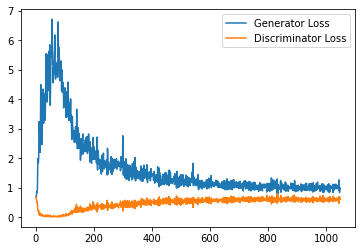

Step 21500: Generator loss: 0.9925392110347748, discriminator loss: 0.5992330928444862


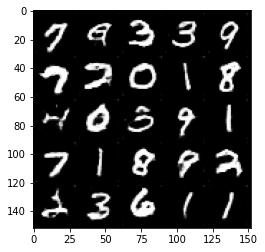

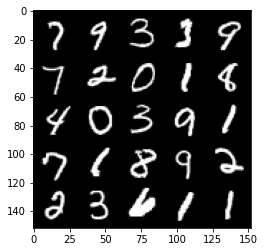

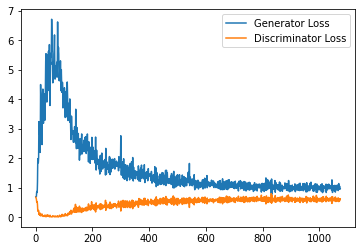

Step 22000: Generator loss: 1.0003667480945586, discriminator loss: 0.5963765822052955


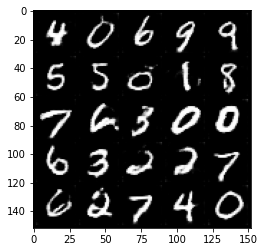

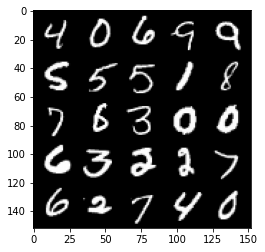

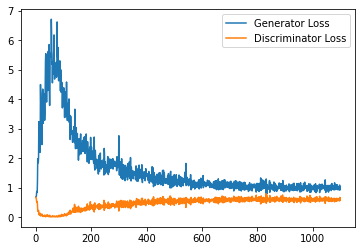

Step 22500: Generator loss: 1.0050936909914017, discriminator loss: 0.5956594622135163


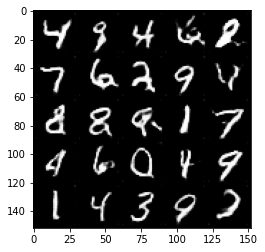

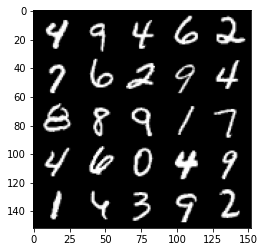

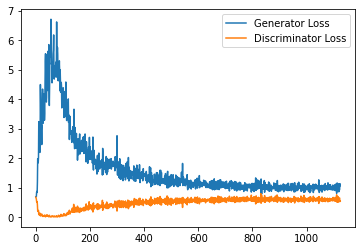

Step 23000: Generator loss: 0.9600012593269348, discriminator loss: 0.6005637990236282


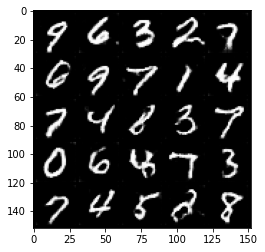

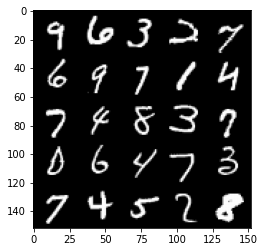

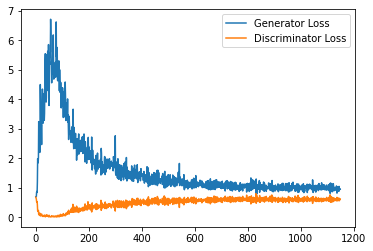

Step 23500: Generator loss: 1.011394928216934, discriminator loss: 0.5952938175797462


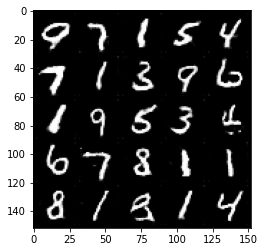

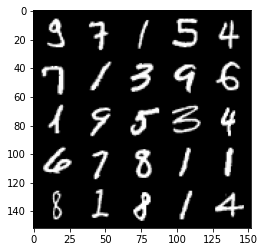

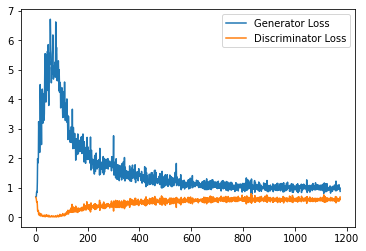

Step 24000: Generator loss: 0.9888010894060135, discriminator loss: 0.599158497095108


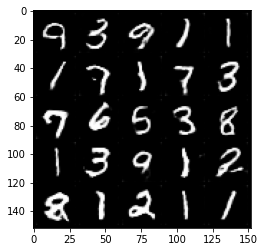

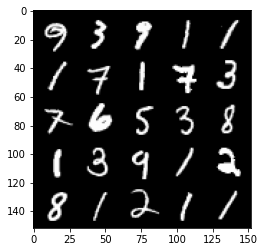

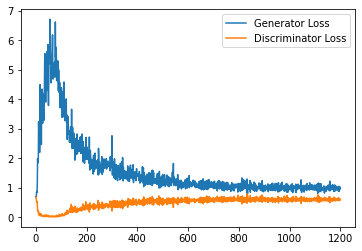

Step 24500: Generator loss: 0.9865962302684784, discriminator loss: 0.5986353540420533


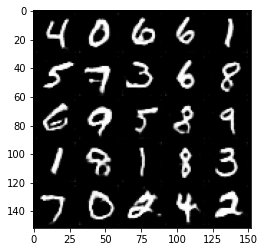

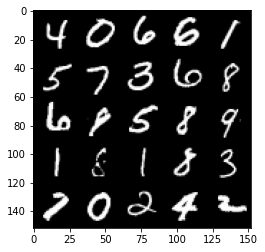

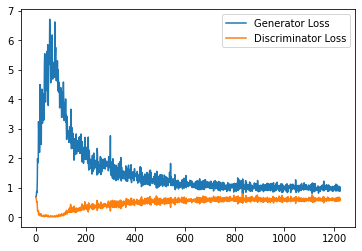

Step 25000: Generator loss: 0.975455132484436, discriminator loss: 0.6024436028599739


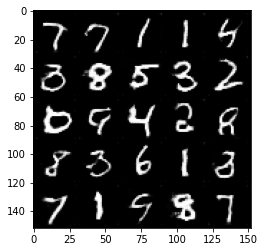

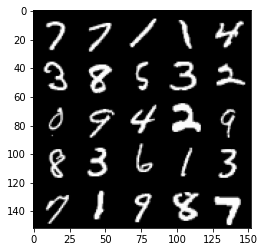

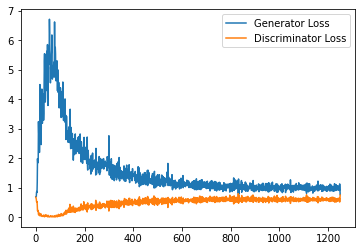

Step 25500: Generator loss: 0.9892675060033799, discriminator loss: 0.5952333505153656


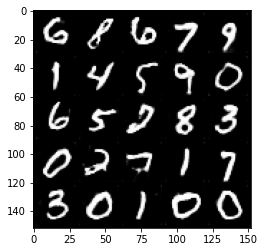

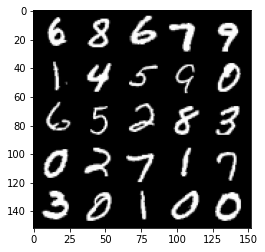

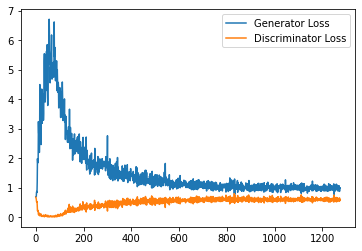

Step 26000: Generator loss: 0.9805199643373489, discriminator loss: 0.5910456541180611


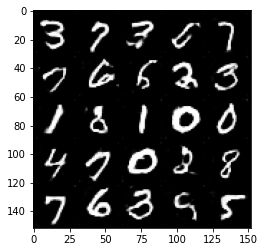

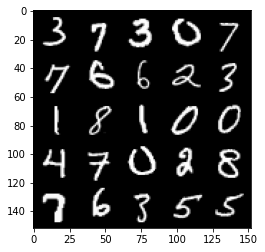

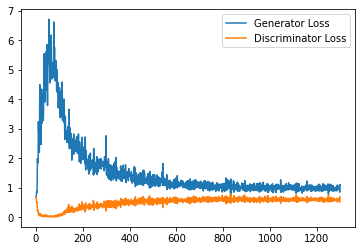

Step 26500: Generator loss: 0.9863044710159302, discriminator loss: 0.6008585319519043


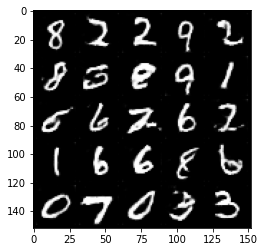

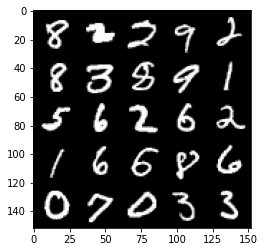

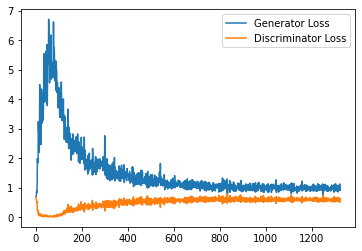

Step 27000: Generator loss: 0.9857071344852447, discriminator loss: 0.5950866417884827


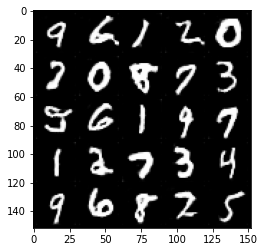

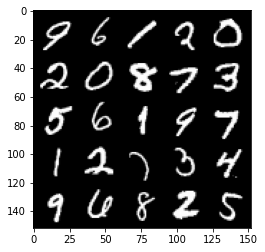

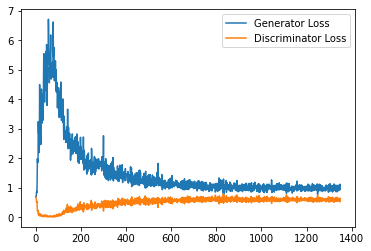

Step 27500: Generator loss: 0.988884925365448, discriminator loss: 0.6002285352349281


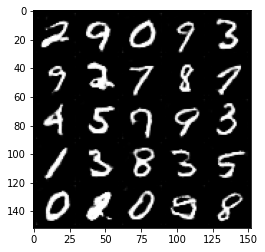

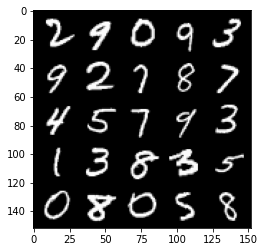

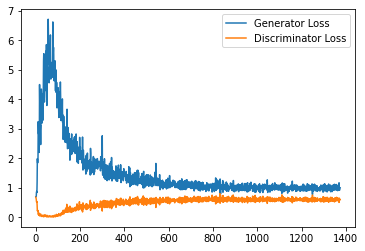

Step 28000: Generator loss: 0.9813943668603897, discriminator loss: 0.5960779381990433


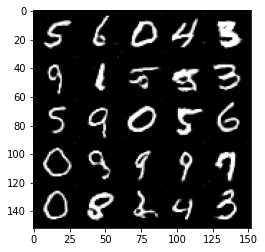

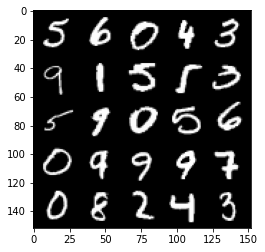

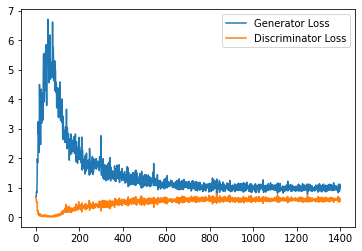

Step 28500: Generator loss: 1.0104391202926635, discriminator loss: 0.5917378655076027


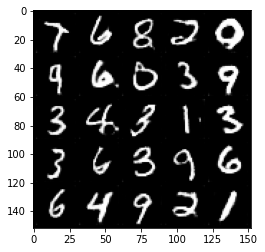

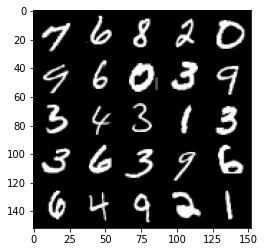

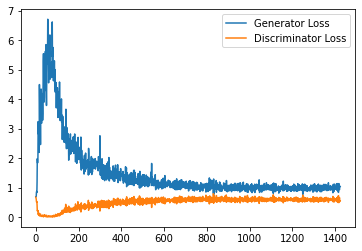

Step 29000: Generator loss: 1.0138872356414794, discriminator loss: 0.600095694243908


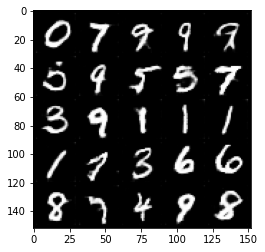

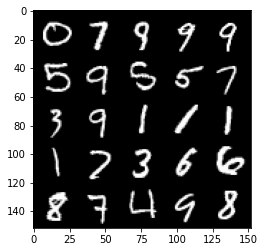

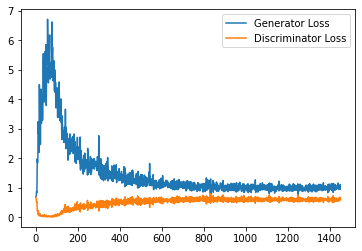

Step 29500: Generator loss: 0.9810880976915359, discriminator loss: 0.5980279673933983


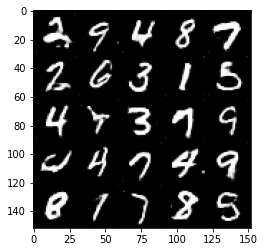

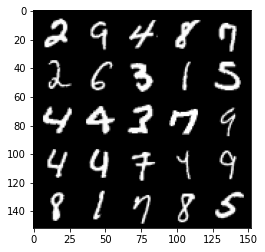

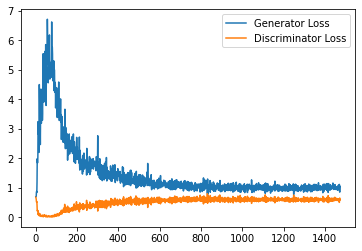

Step 30000: Generator loss: 0.9767667517662049, discriminator loss: 0.5988269139528275


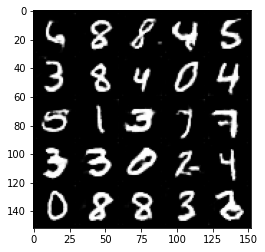

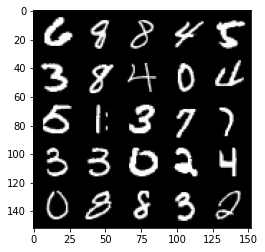

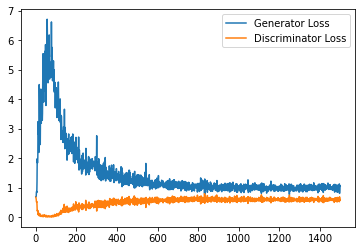

Step 30500: Generator loss: 0.992729425907135, discriminator loss: 0.595083523452282


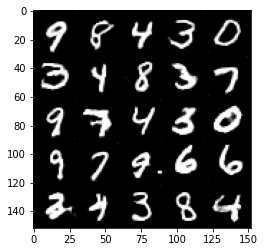

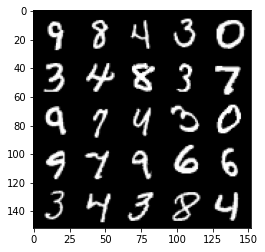

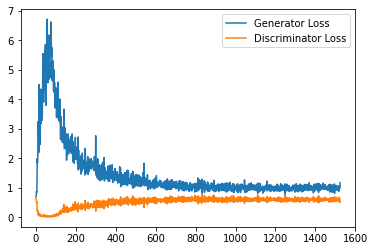

Step 31000: Generator loss: 0.9875848978757858, discriminator loss: 0.5988570742607117


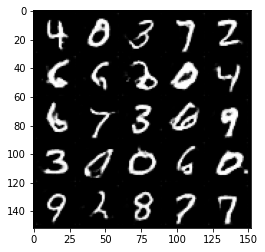

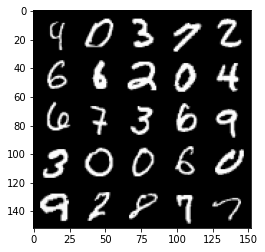

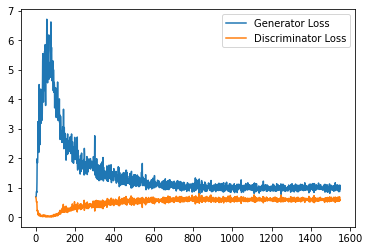

Step 31500: Generator loss: 0.9812307374477387, discriminator loss: 0.5942178276777268


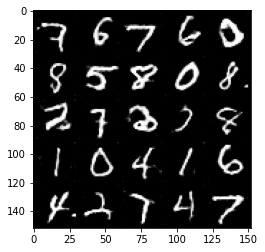

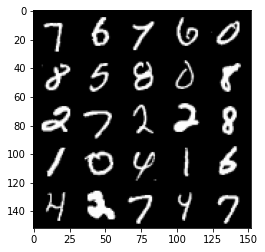

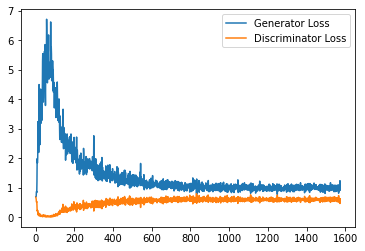

Step 32000: Generator loss: 0.9882923710346222, discriminator loss: 0.5979665723443032


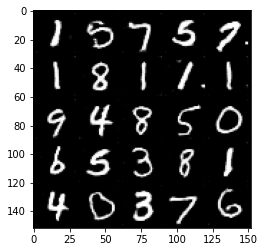

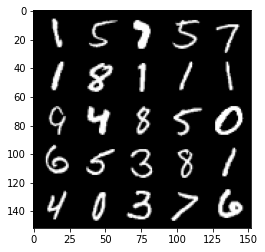

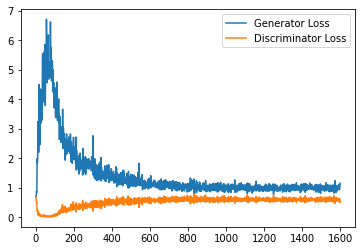

Step 32500: Generator loss: 0.995015571475029, discriminator loss: 0.597088557422161


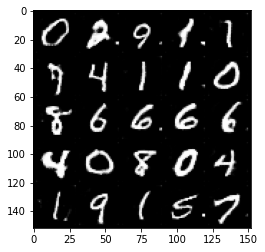

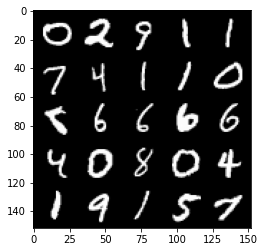

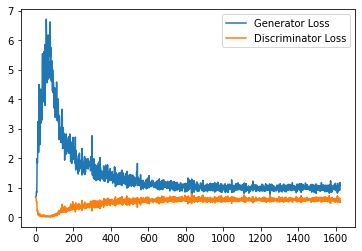

Step 33000: Generator loss: 0.9758475227355957, discriminator loss: 0.6014946836829186


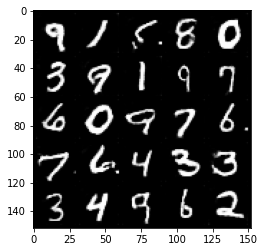

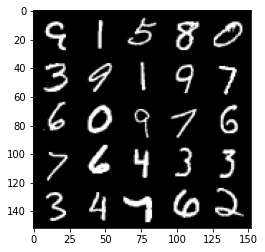

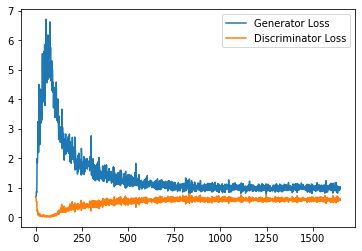

Step 33500: Generator loss: 0.9935744924545288, discriminator loss: 0.5951265161633491


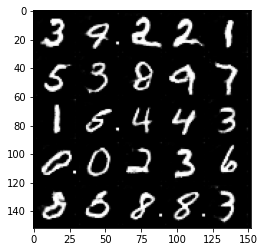

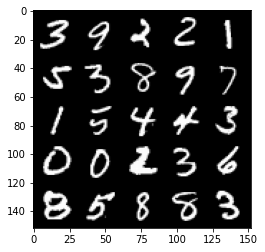

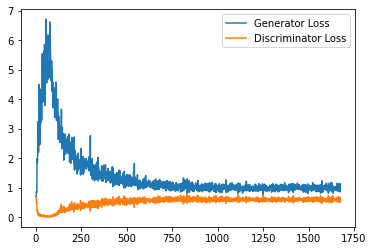

Step 34000: Generator loss: 0.9793395882844925, discriminator loss: 0.6023925780653954


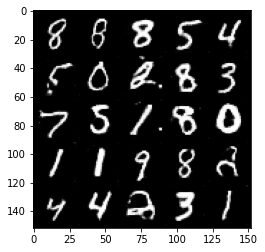

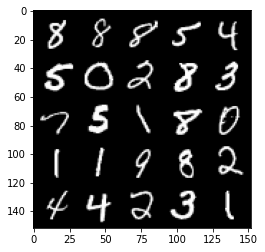

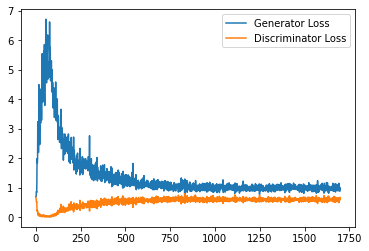

Step 34500: Generator loss: 0.9692996649742126, discriminator loss: 0.596784541785717


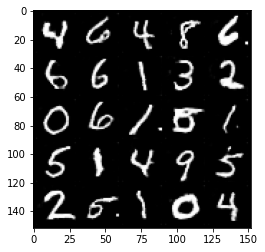

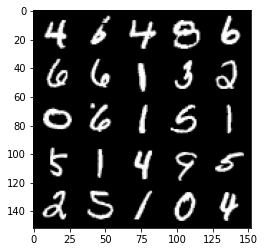

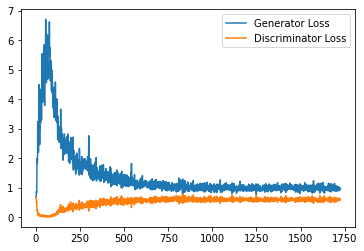

Step 35000: Generator loss: 0.991990263581276, discriminator loss: 0.5967425838112831


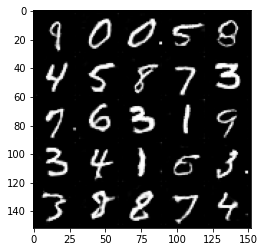

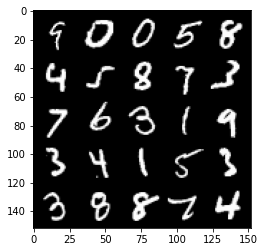

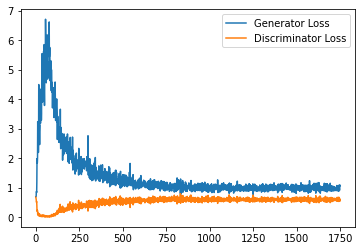

Step 35500: Generator loss: 1.0058151136636735, discriminator loss: 0.5992888605594635


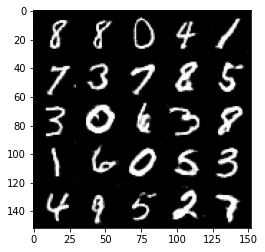

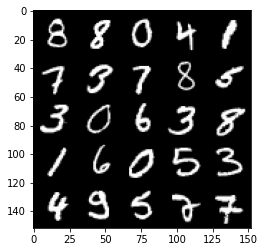

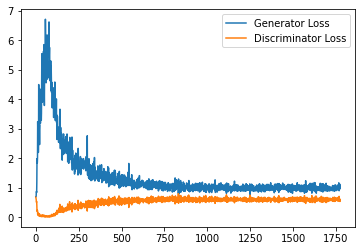

Step 36000: Generator loss: 0.9778792082071305, discriminator loss: 0.600360590994358


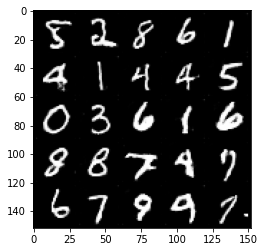

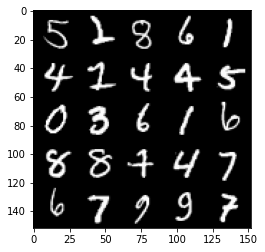

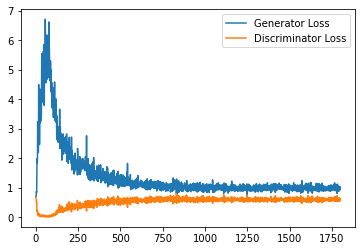

Step 36500: Generator loss: 0.9940951437950134, discriminator loss: 0.5933788723945618


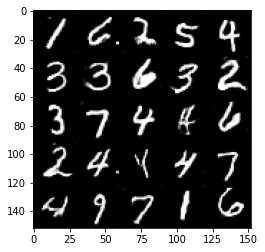

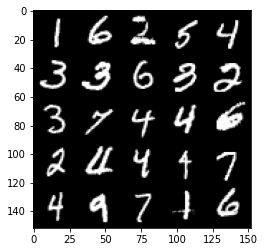

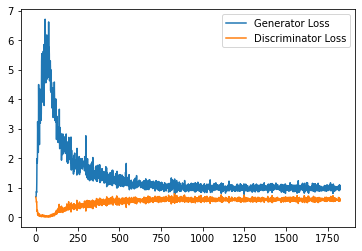

Step 37000: Generator loss: 0.9970932842493058, discriminator loss: 0.600798940718174


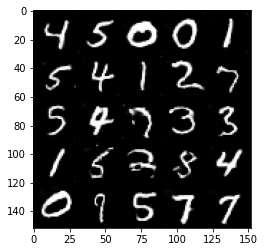

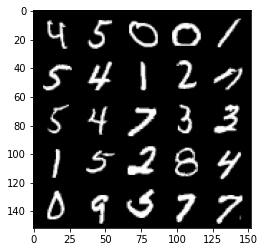

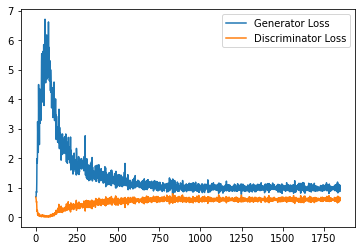

Step 37500: Generator loss: 0.9901307874917984, discriminator loss: 0.5901187010407448


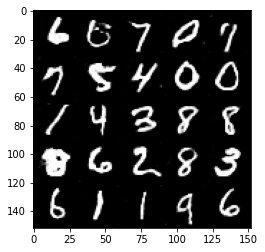

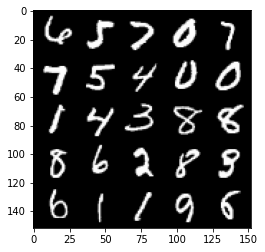

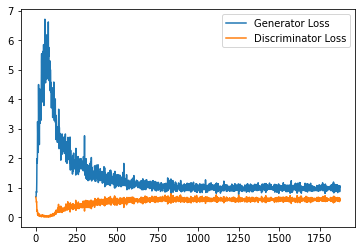

Step 38000: Generator loss: 0.9930220631361008, discriminator loss: 0.5957877840995789


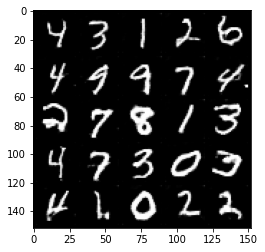

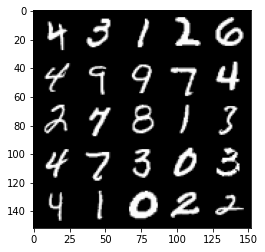

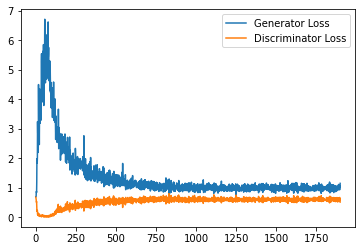

Step 38500: Generator loss: 0.9948033744096756, discriminator loss: 0.5997319723963738


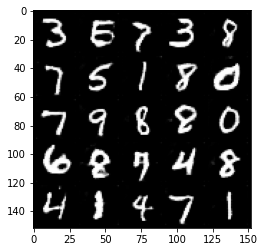

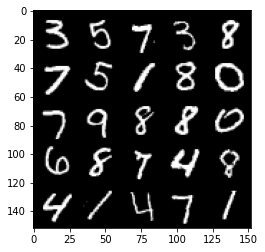

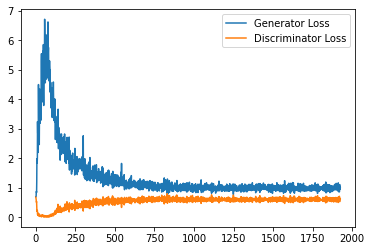

Step 39000: Generator loss: 1.0067983176708222, discriminator loss: 0.5921899201869965


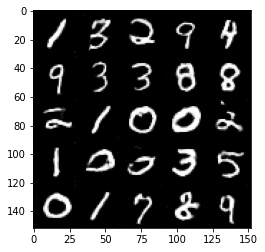

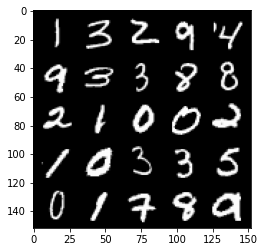

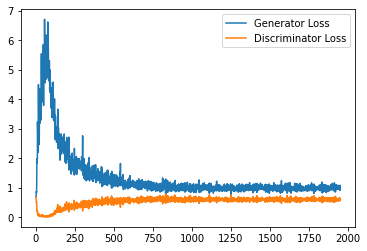

Step 39500: Generator loss: 0.9801037024259567, discriminator loss: 0.5933692888021469


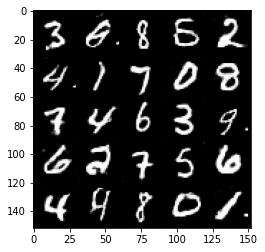

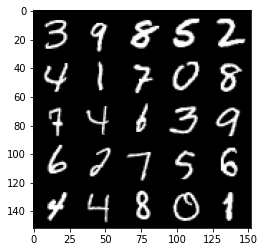

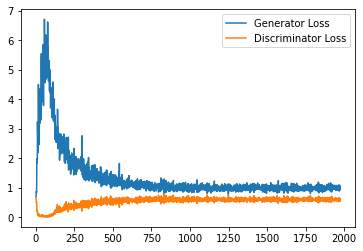

Step 40000: Generator loss: 0.9772128816843033, discriminator loss: 0.5945212863087654


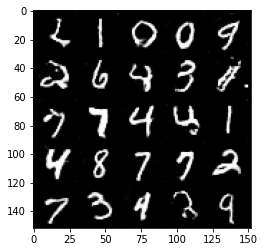

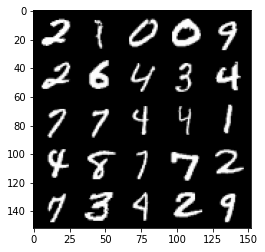

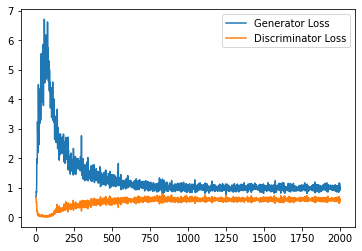

Step 40500: Generator loss: 0.9983909859657287, discriminator loss: 0.5945214105844497


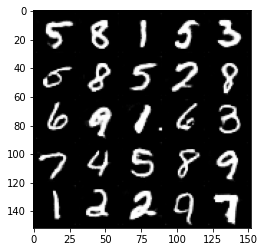

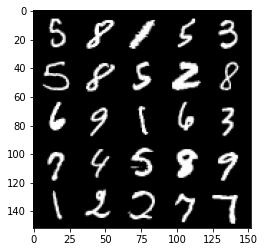

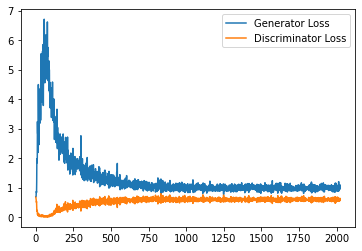

Step 41000: Generator loss: 0.9900359622240067, discriminator loss: 0.5880088099241256


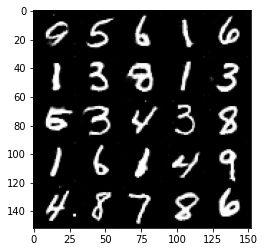

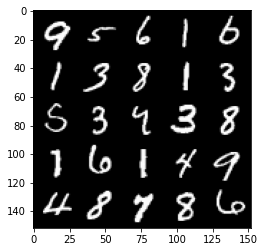

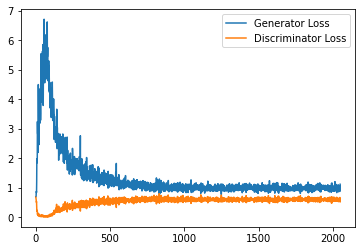

Step 41500: Generator loss: 0.9920609456300735, discriminator loss: 0.5934322885274887


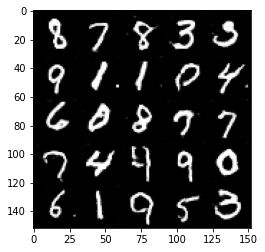

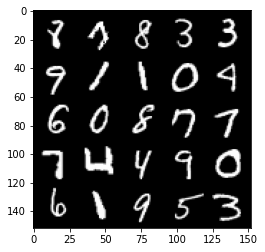

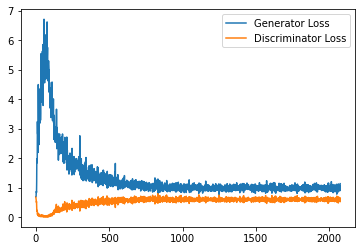

Step 42000: Generator loss: 0.9977954273223877, discriminator loss: 0.5969058527946473


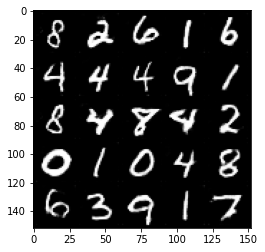

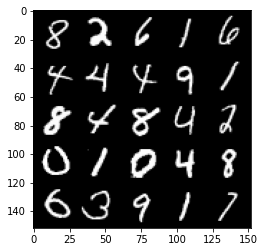

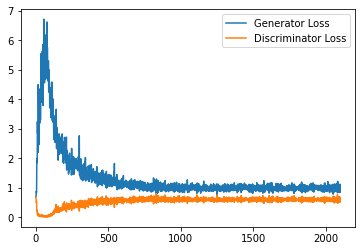

Step 42500: Generator loss: 1.00085913169384, discriminator loss: 0.5927192575335503


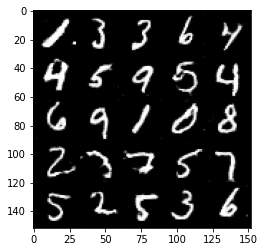

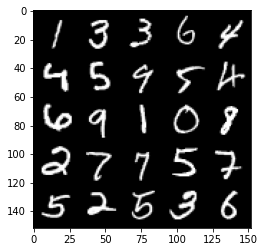

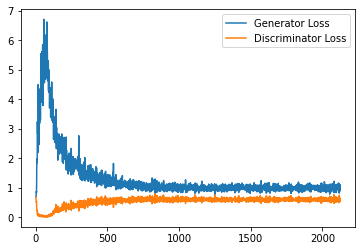

Step 43000: Generator loss: 1.0064289766550063, discriminator loss: 0.5950662113428116


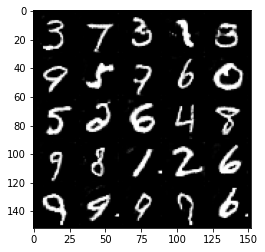

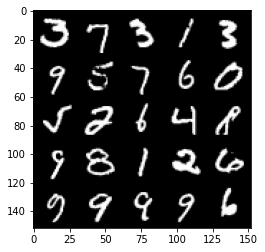

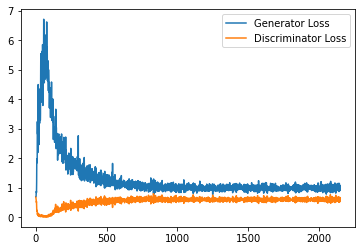

Step 43500: Generator loss: 0.990307125210762, discriminator loss: 0.5907886010408402


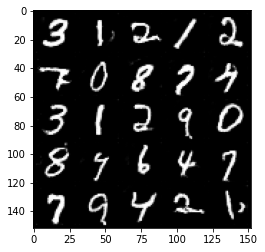

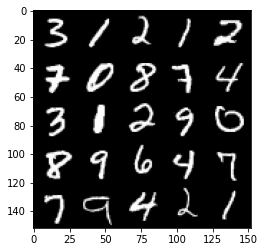

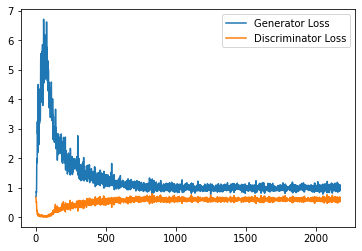

Step 44000: Generator loss: 1.0229507917165757, discriminator loss: 0.5901282019019127


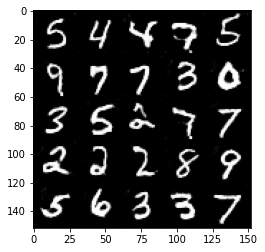

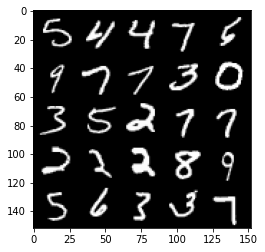

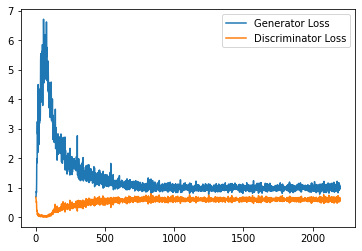

Step 44500: Generator loss: 0.9929291142225265, discriminator loss: 0.5934011904001236


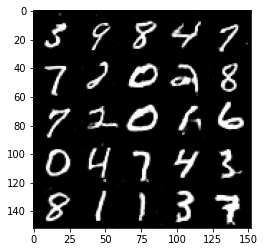

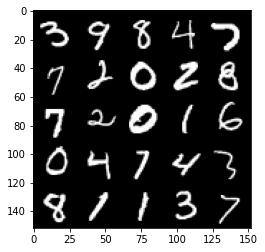

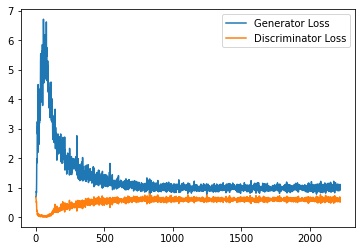

Step 45000: Generator loss: 0.995294996380806, discriminator loss: 0.5896074997186661


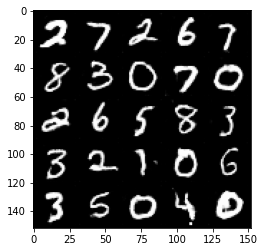

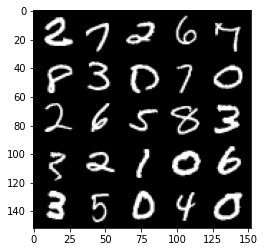

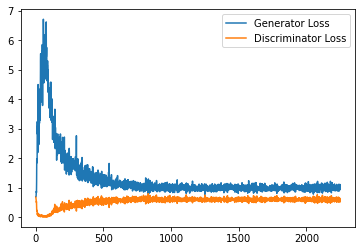

Step 45500: Generator loss: 0.9948066800832749, discriminator loss: 0.5947457016706467


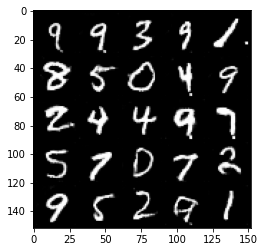

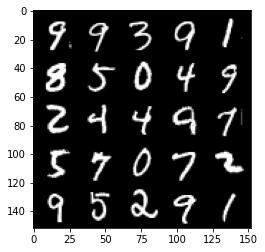

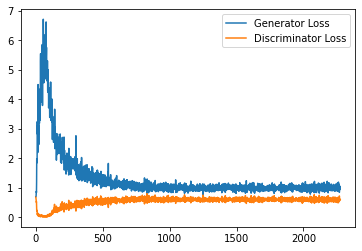

Step 46000: Generator loss: 1.0119789724349975, discriminator loss: 0.5841103069782257


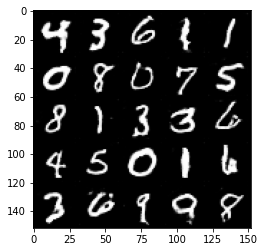

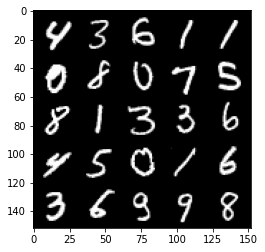

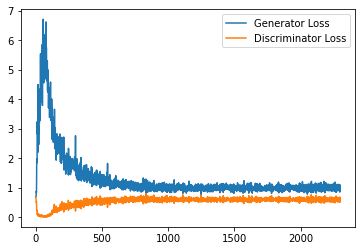

Step 46500: Generator loss: 0.9844458045959472, discriminator loss: 0.5866947538256645


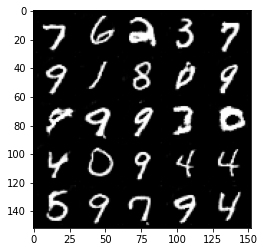

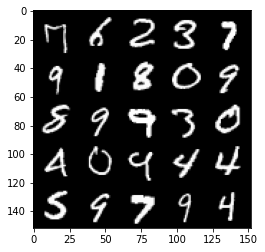

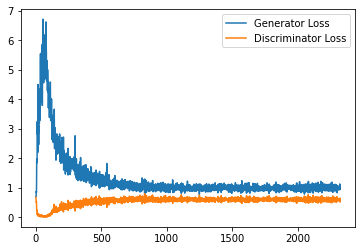

Step 47000: Generator loss: 0.9974814451932907, discriminator loss: 0.5868292146325111


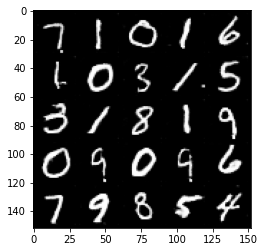

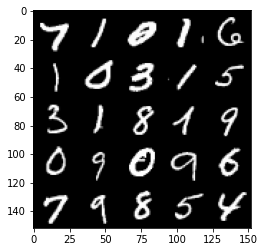

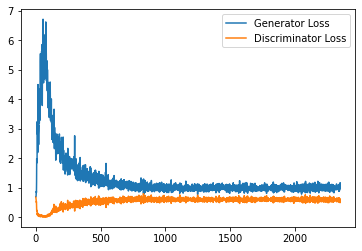

Step 47500: Generator loss: 1.005949844121933, discriminator loss: 0.584645126581192


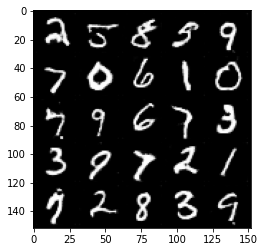

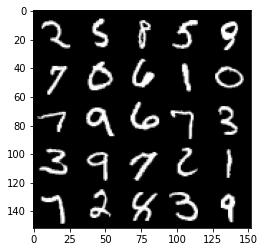

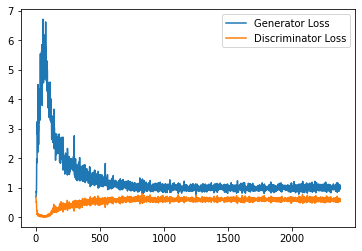

Step 48000: Generator loss: 1.0160065344572067, discriminator loss: 0.588367210328579


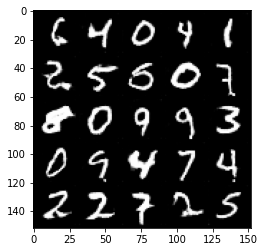

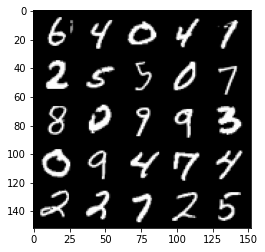

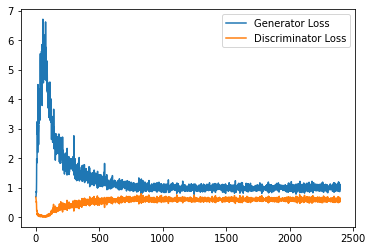

Step 48500: Generator loss: 1.027928691148758, discriminator loss: 0.5857345670461654


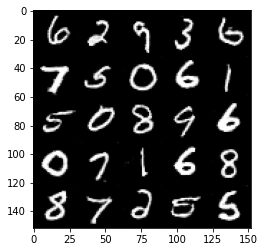

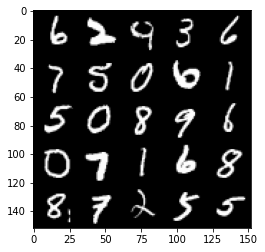

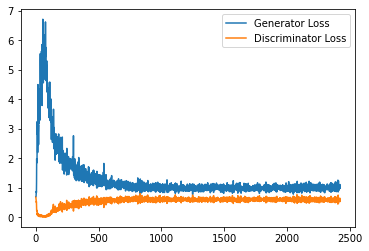

Step 49000: Generator loss: 1.0233970683813096, discriminator loss: 0.5837370654344559


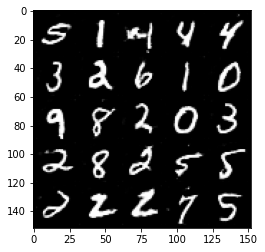

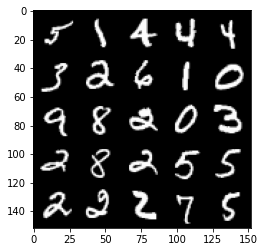

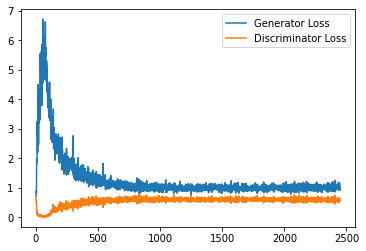

Step 49500: Generator loss: 1.0228052743673324, discriminator loss: 0.5874908168315888


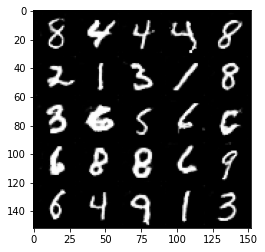

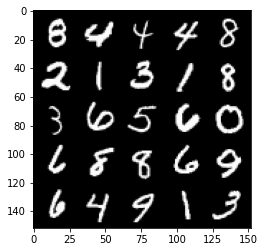

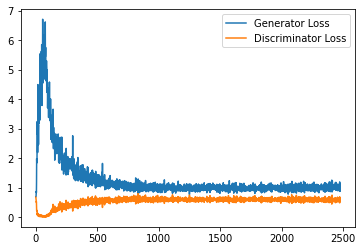

Step 50000: Generator loss: 1.009064473748207, discriminator loss: 0.5854575455784797


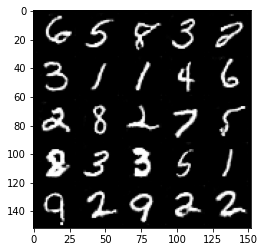

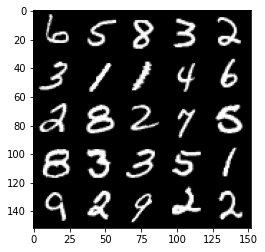

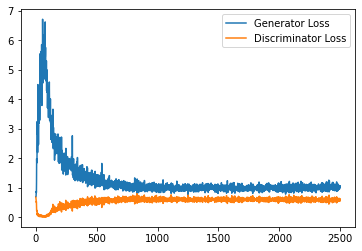

Step 50500: Generator loss: 1.0230558270215988, discriminator loss: 0.5839314029216767


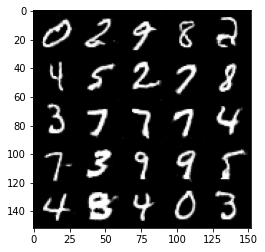

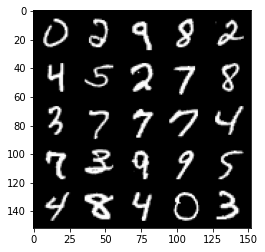

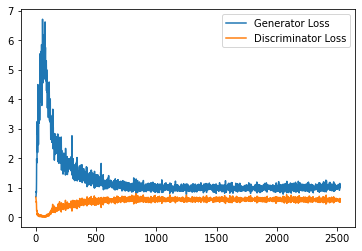

Step 51000: Generator loss: 1.0038800053596497, discriminator loss: 0.5903206279277802


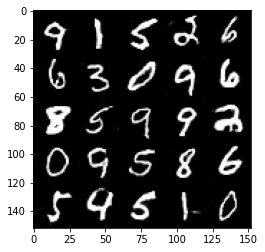

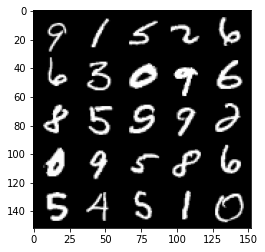

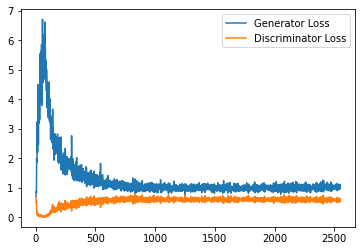

Step 51500: Generator loss: 1.017153881430626, discriminator loss: 0.5833569928407669


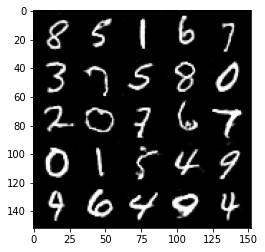

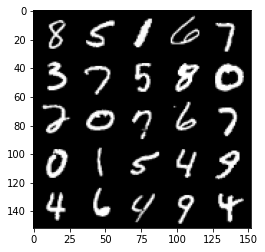

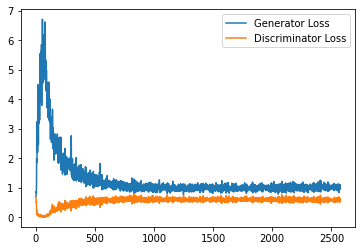

Step 52000: Generator loss: 0.9828603242635727, discriminator loss: 0.5878438418507576


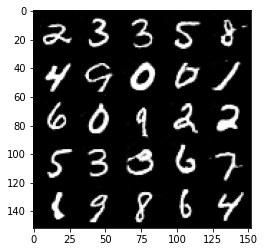

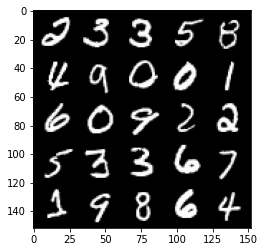

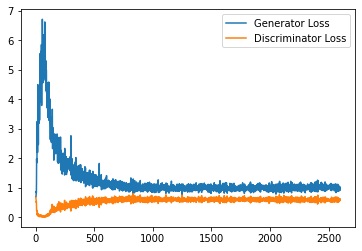

Step 52500: Generator loss: 1.00212641620636, discriminator loss: 0.5856565790176391


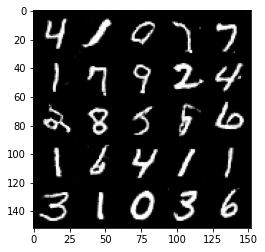

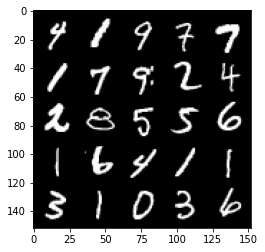

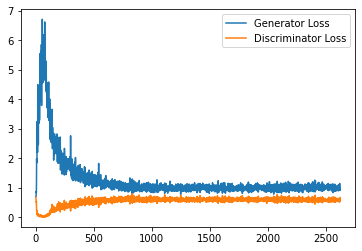

Step 53000: Generator loss: 1.0333444378376007, discriminator loss: 0.5874069831371307


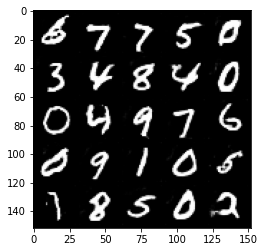

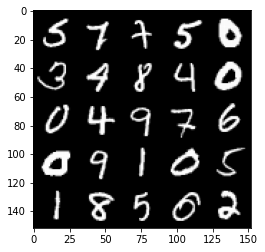

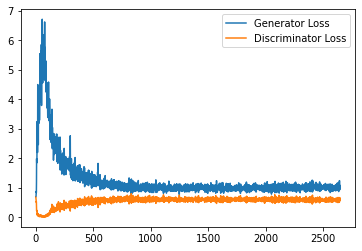

Step 53500: Generator loss: 1.0104453955888748, discriminator loss: 0.5857863909006119


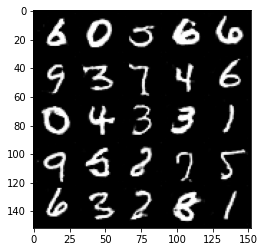

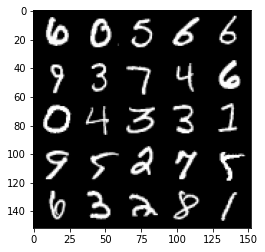

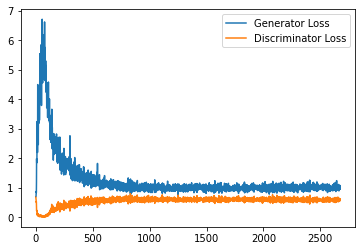

Step 54000: Generator loss: 1.0252197723388672, discriminator loss: 0.5816797397732735


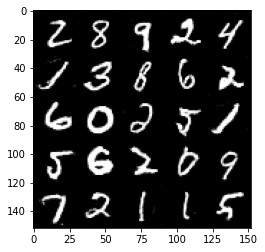

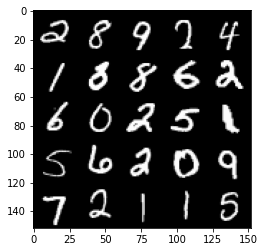

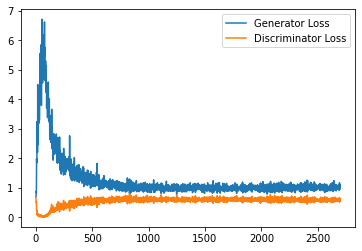

Step 54500: Generator loss: 1.0147239298820496, discriminator loss: 0.5860059458017349


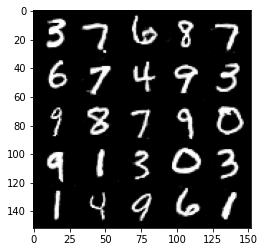

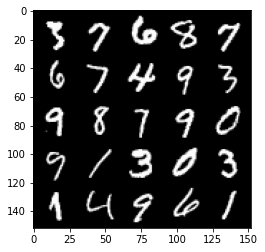

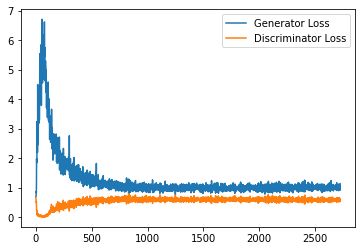

Step 55000: Generator loss: 1.0116196852922439, discriminator loss: 0.5871433299779892


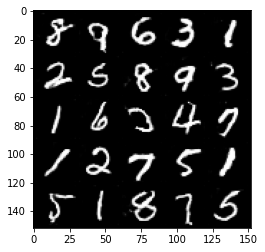

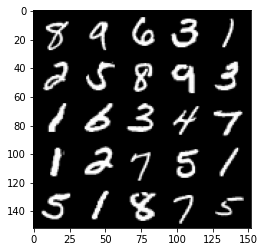

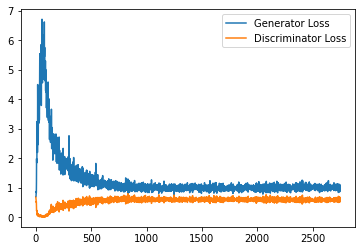

Step 55500: Generator loss: 0.9911889947652817, discriminator loss: 0.5901486300826073


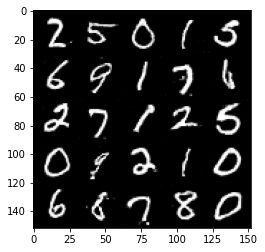

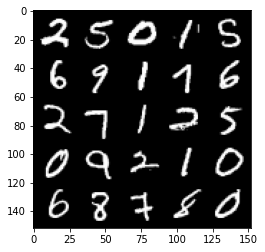

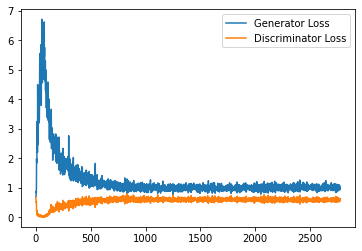

Step 56000: Generator loss: 1.0074562704563141, discriminator loss: 0.5798310173153878


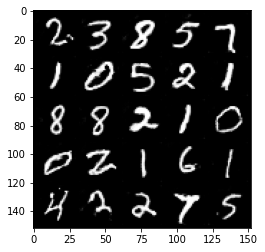

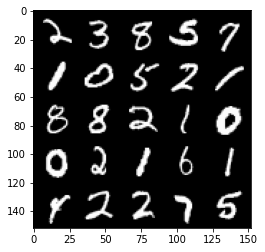

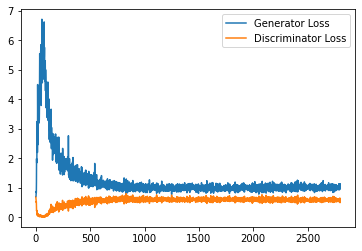

Step 56500: Generator loss: 1.0436253242492677, discriminator loss: 0.57979131513834


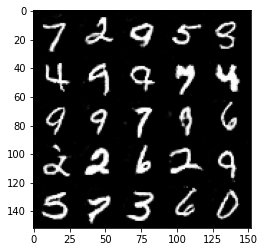

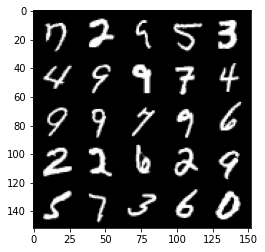

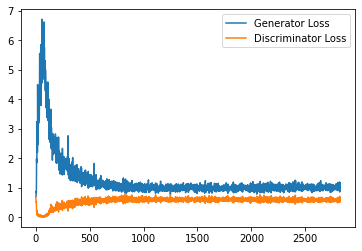

Step 57000: Generator loss: 1.0056181652545928, discriminator loss: 0.5909921917915344


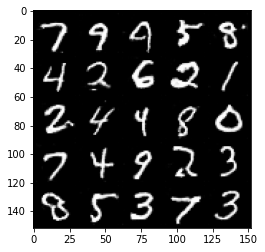

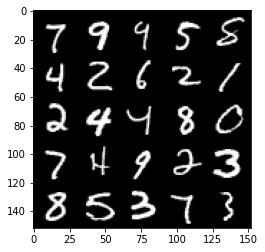

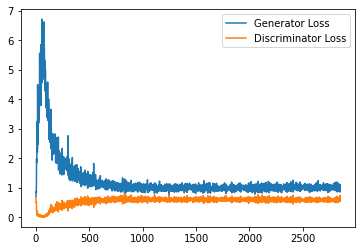

Step 57500: Generator loss: 1.0369518533945083, discriminator loss: 0.5830001648664475


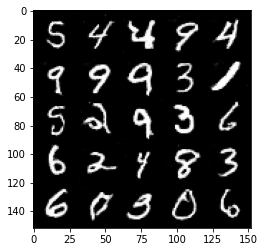

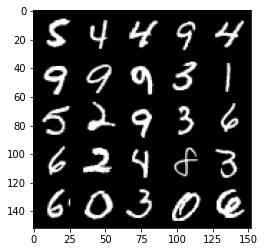

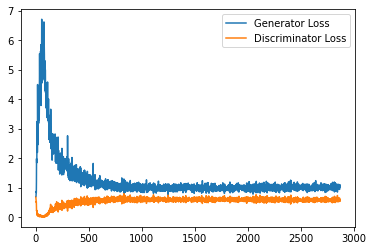

Step 58000: Generator loss: 1.0410209938287736, discriminator loss: 0.5829877057671546


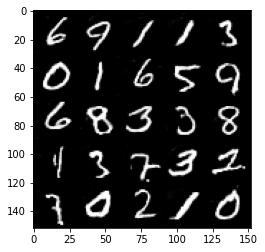

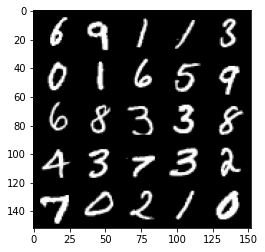

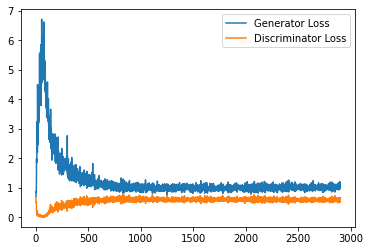

Step 58500: Generator loss: 1.010134520173073, discriminator loss: 0.5826065266728401


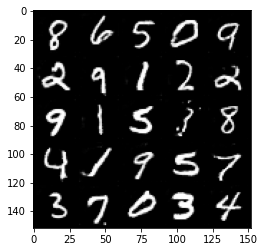

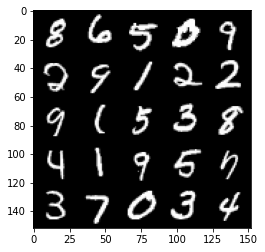

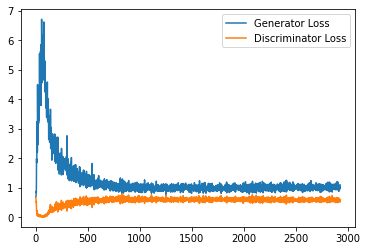

Step 59000: Generator loss: 1.0288087023496628, discriminator loss: 0.5841494823098182


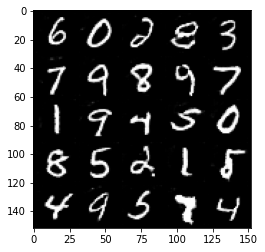

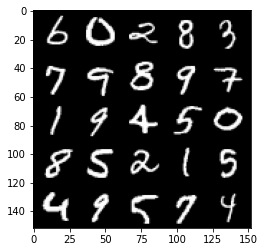

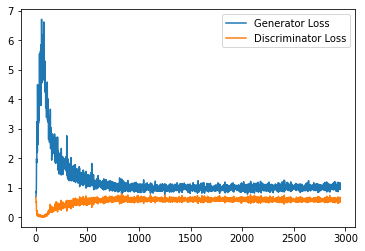

Step 59500: Generator loss: 1.0053022158145906, discriminator loss: 0.5868828696012497


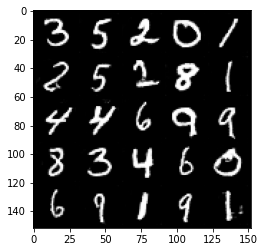

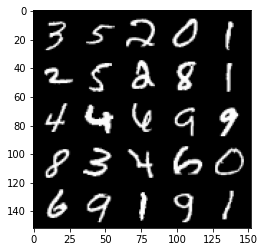

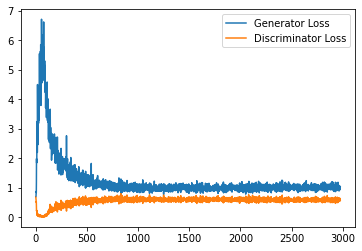

Step 60000: Generator loss: 1.0270451164245606, discriminator loss: 0.5863442023396492


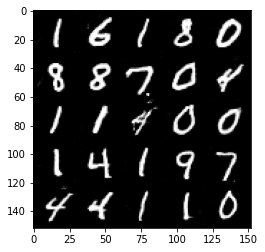

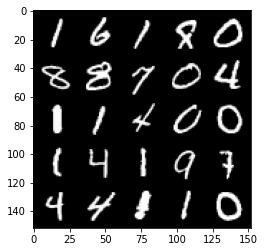

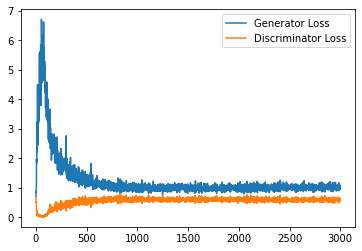

Step 60500: Generator loss: 1.0011627950668336, discriminator loss: 0.5878895826339722


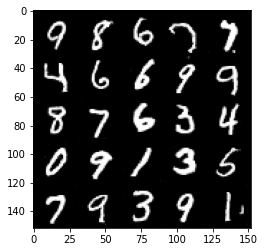

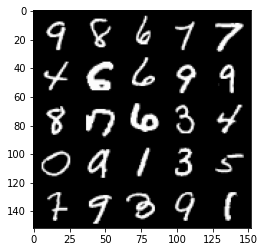

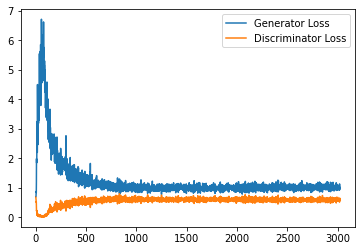

Step 61000: Generator loss: 1.0132420761585235, discriminator loss: 0.5875731896162033


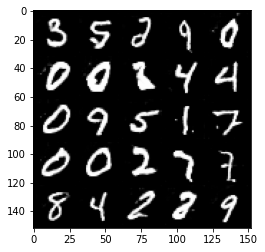

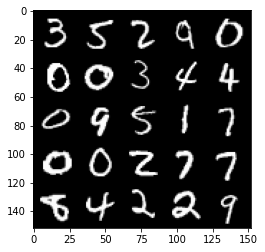

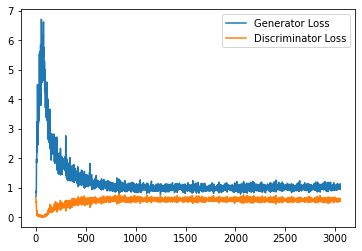

Step 61500: Generator loss: 1.0294293518066406, discriminator loss: 0.5867564910054207


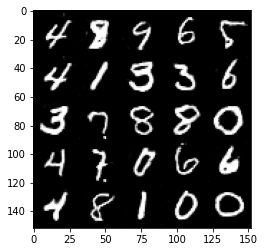

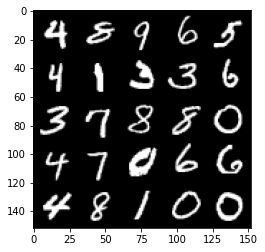

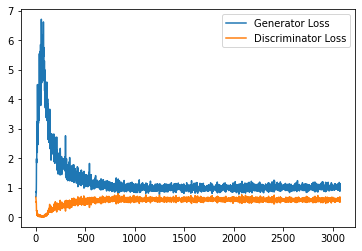

Step 62000: Generator loss: 0.9948437662124634, discriminator loss: 0.5906881769895553


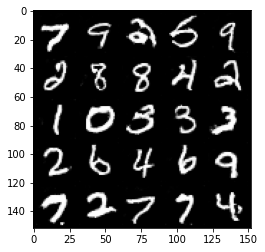

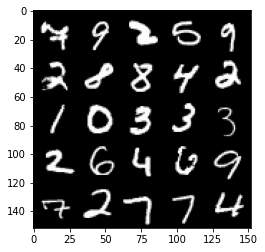

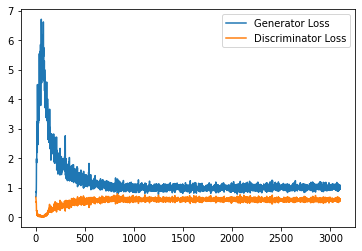

Step 62500: Generator loss: 1.0229420516490937, discriminator loss: 0.5902399915456772


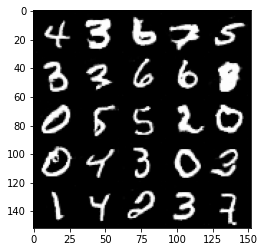

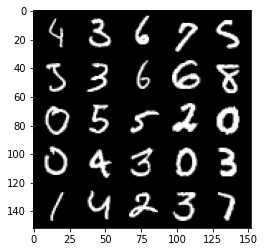

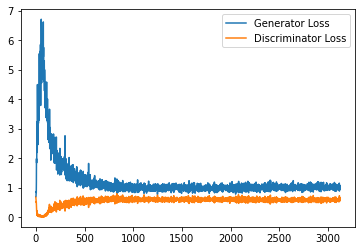

Step 63000: Generator loss: 1.0074974573850632, discriminator loss: 0.589251058101654


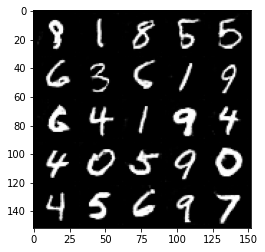

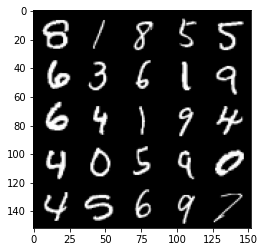

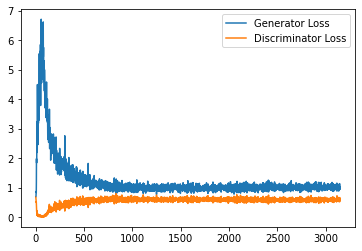

Step 63500: Generator loss: 1.006859629869461, discriminator loss: 0.5862997228503227


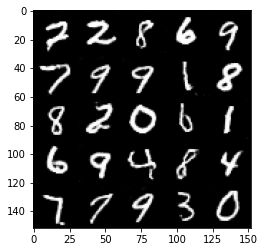

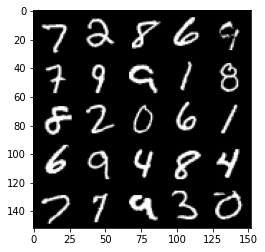

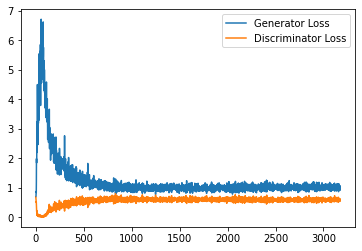

Step 64000: Generator loss: 0.9990339922904968, discriminator loss: 0.5976265953779221


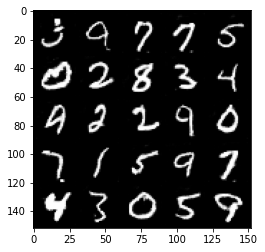

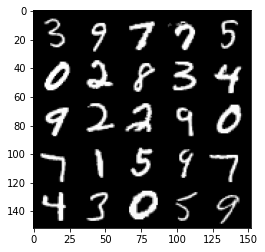

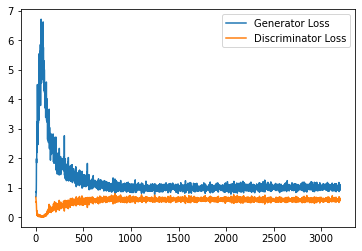

Step 64500: Generator loss: 0.9995535945892334, discriminator loss: 0.5911547400951386


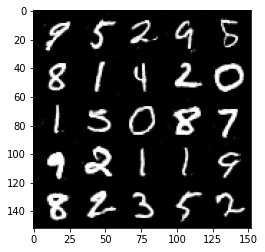

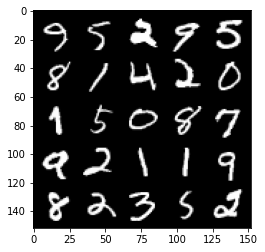

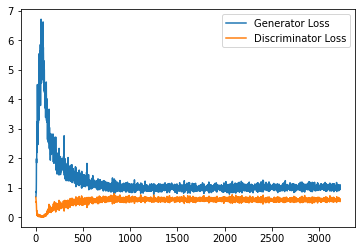

Step 65000: Generator loss: 1.0132071900367736, discriminator loss: 0.5925686739683151


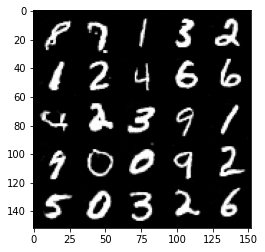

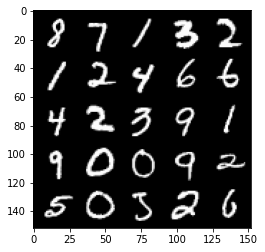

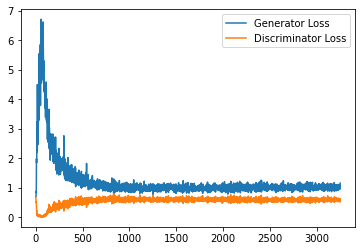

Step 65500: Generator loss: 0.9985079511404037, discriminator loss: 0.5959463279247283


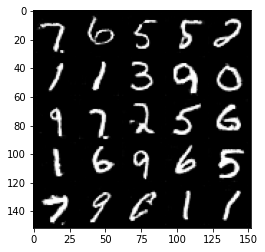

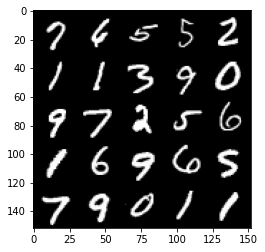

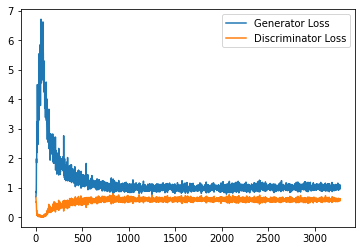

Step 66000: Generator loss: 0.9982738130092621, discriminator loss: 0.5958695288300514


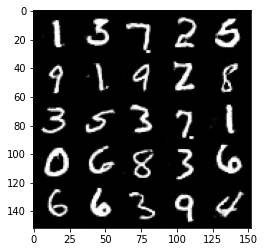

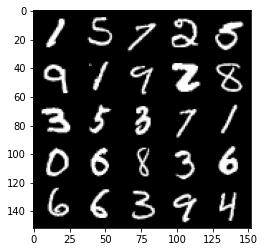

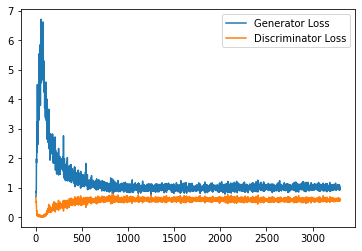

Step 66500: Generator loss: 0.9911665043830872, discriminator loss: 0.5942982219457627


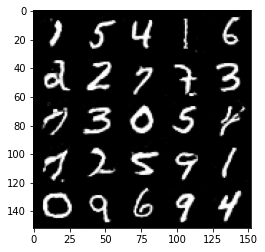

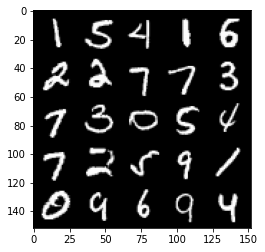

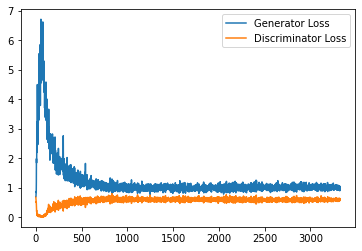

Step 67000: Generator loss: 1.0091235243082046, discriminator loss: 0.5966818318367004


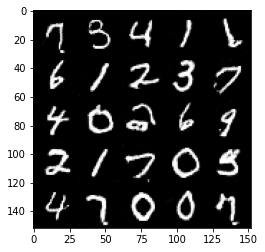

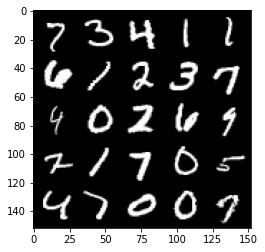

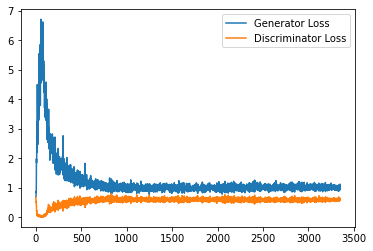

Step 67500: Generator loss: 1.0131173404455185, discriminator loss: 0.5959264969229698


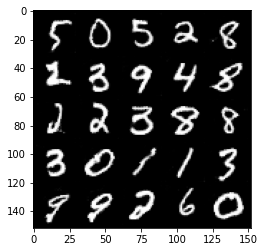

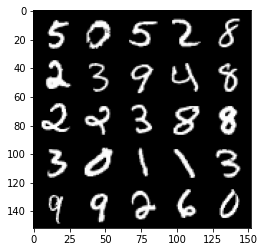

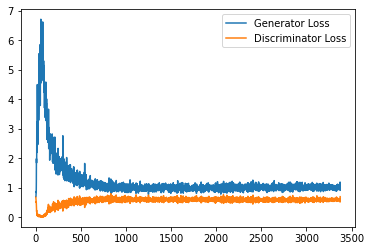

Step 68000: Generator loss: 0.9895418890714646, discriminator loss: 0.5919335146546364


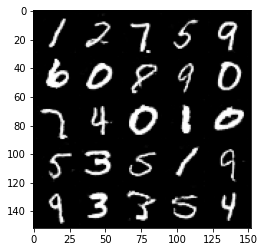

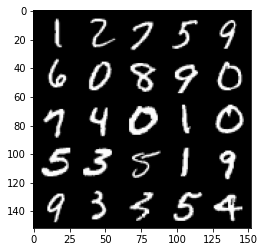

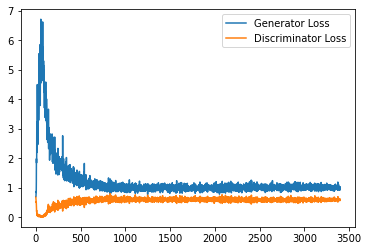

Step 68500: Generator loss: 0.9951688017845154, discriminator loss: 0.5980810684561729


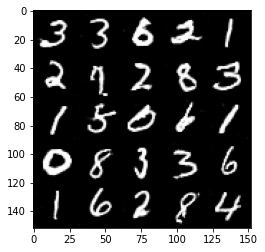

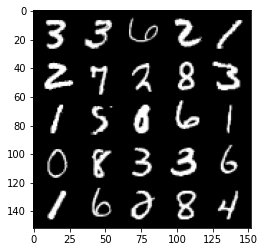

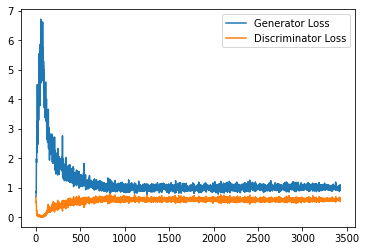

Step 69000: Generator loss: 0.9958615797758102, discriminator loss: 0.5968636463284492


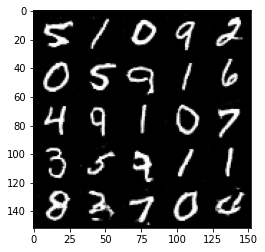

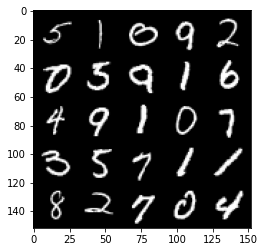

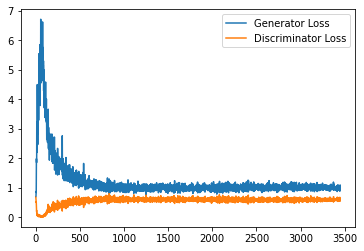

Step 69500: Generator loss: 1.0359236295223235, discriminator loss: 0.5913910455107689


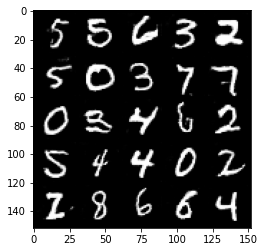

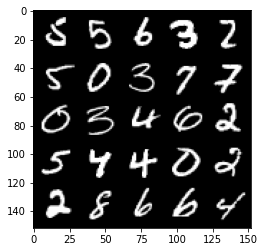

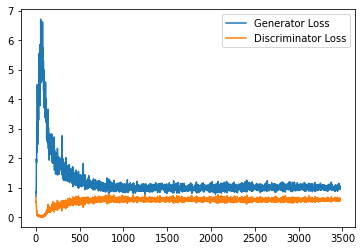

Step 70000: Generator loss: 0.9946122626066208, discriminator loss: 0.5960370910167694


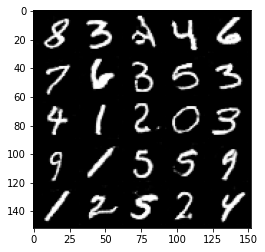

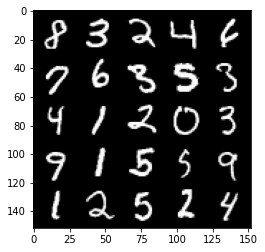

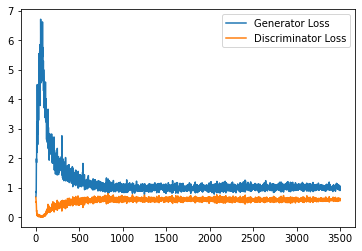

Step 70500: Generator loss: 1.0143901571035385, discriminator loss: 0.5923691228628158


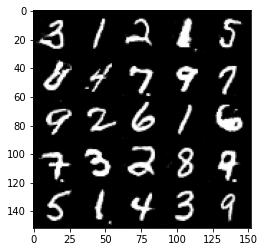

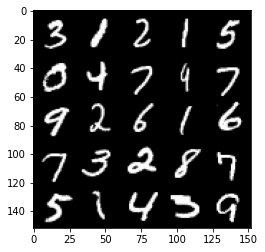

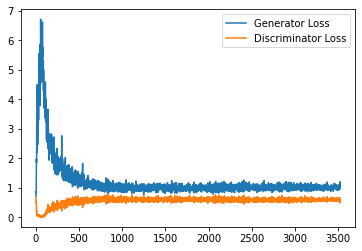

Step 71000: Generator loss: 1.0102618032693862, discriminator loss: 0.595129060804844


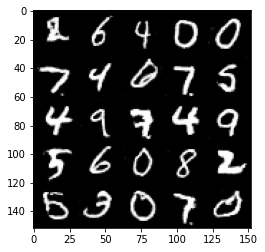

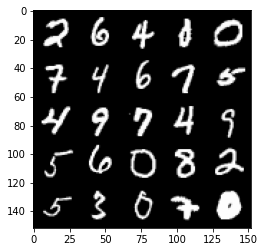

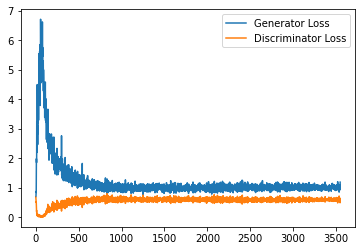

Step 71500: Generator loss: 1.0119450416564941, discriminator loss: 0.5963069522976875


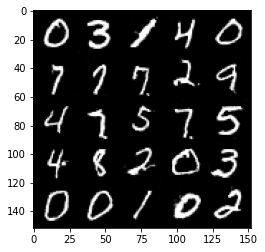

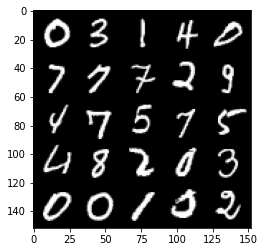

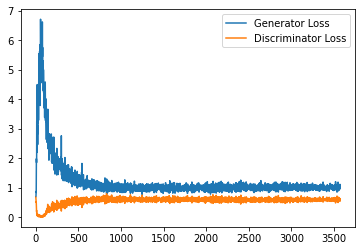

Step 72000: Generator loss: 0.9889668177366256, discriminator loss: 0.5981044828295707


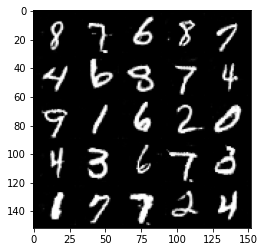

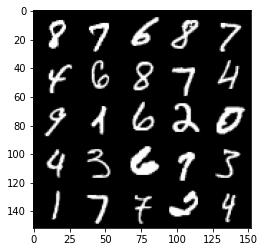

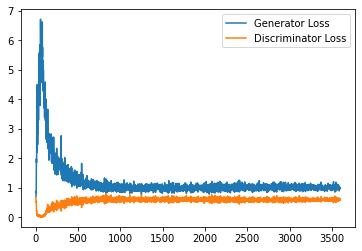

Step 72500: Generator loss: 0.9910978074073792, discriminator loss: 0.5983830336332321


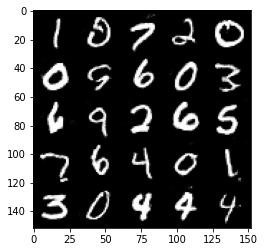

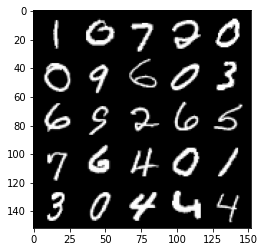

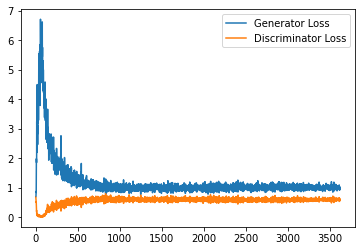

Step 73000: Generator loss: 0.9980811153650284, discriminator loss: 0.5995946877598762


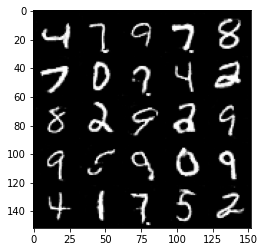

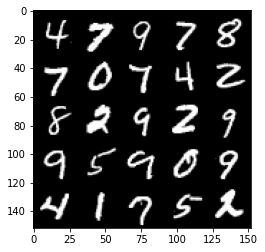

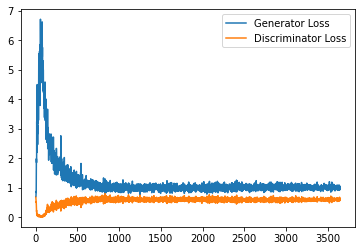

Step 73500: Generator loss: 0.9983528044223785, discriminator loss: 0.598334409058094


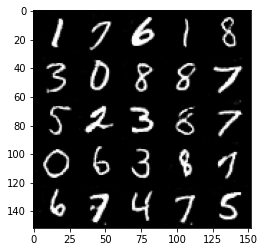

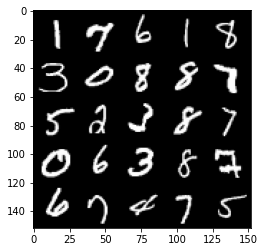

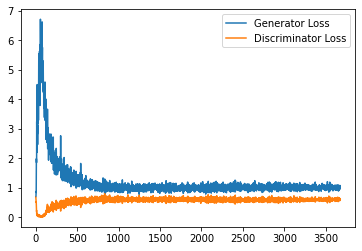

Step 74000: Generator loss: 0.9942311290502548, discriminator loss: 0.5998990179896355


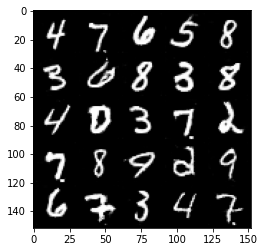

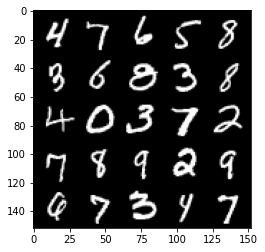

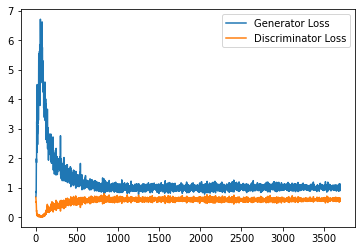

Step 74500: Generator loss: 0.9937560857534409, discriminator loss: 0.6001902214288711


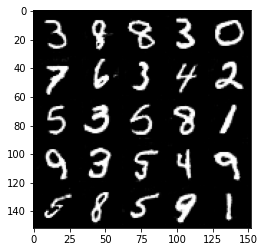

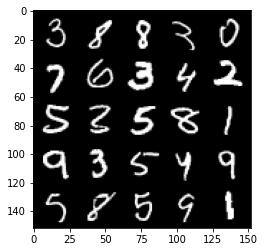

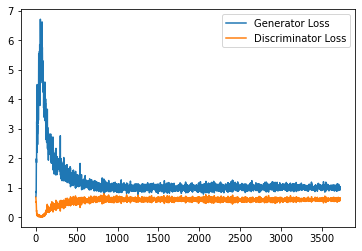

Step 75000: Generator loss: 1.004675905942917, discriminator loss: 0.6001022119522095


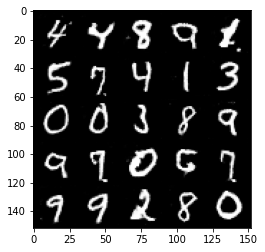

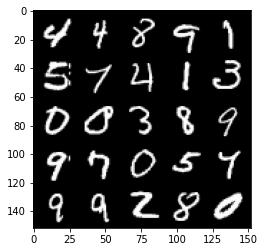

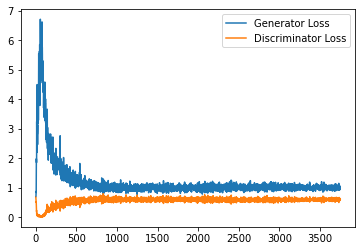

Step 75500: Generator loss: 0.9870725365877151, discriminator loss: 0.5992188539505005


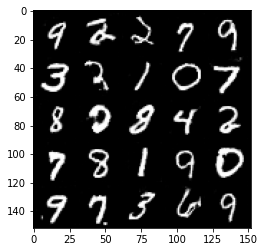

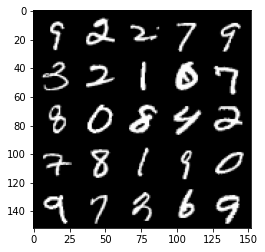

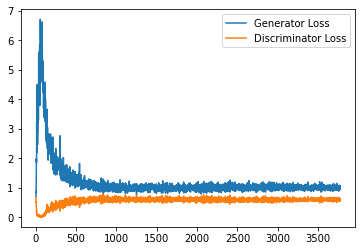

Step 76000: Generator loss: 1.012127677321434, discriminator loss: 0.6002660972476006


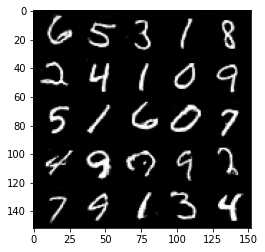

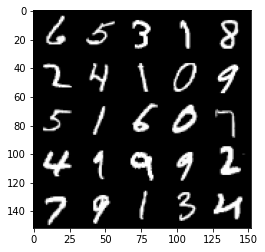

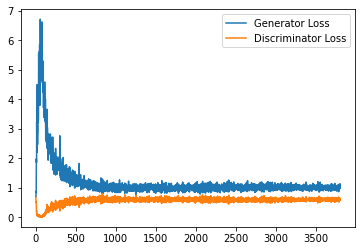

Step 76500: Generator loss: 0.9942003815174103, discriminator loss: 0.5991476433873176


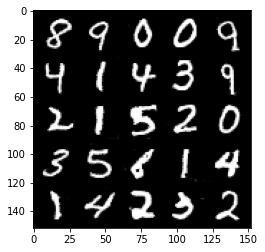

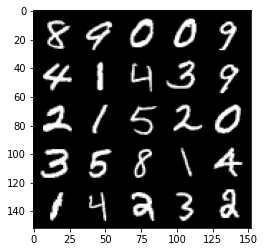

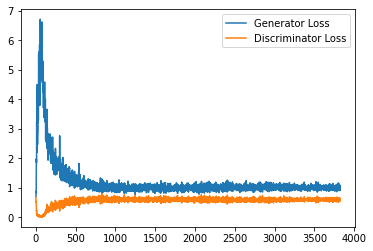

Step 77000: Generator loss: 1.003549641251564, discriminator loss: 0.5931989406347274


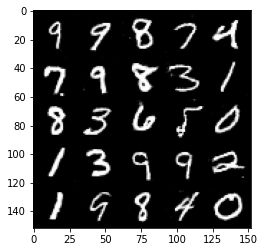

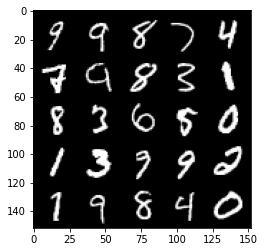

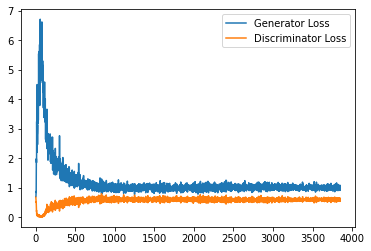

Step 77500: Generator loss: 0.9906250386238098, discriminator loss: 0.5993103631734849


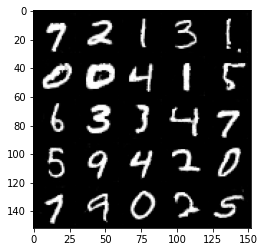

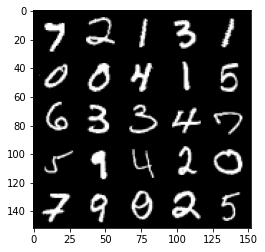

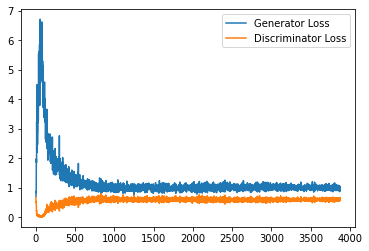

Step 78000: Generator loss: 1.014812286734581, discriminator loss: 0.5950623734593391


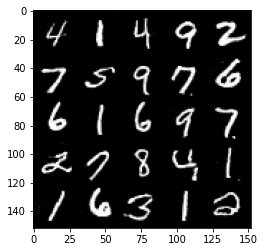

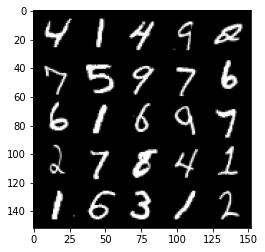

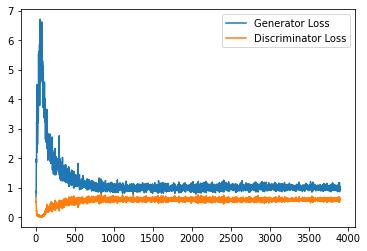

Step 78500: Generator loss: 1.0064634765386582, discriminator loss: 0.6013448143005371


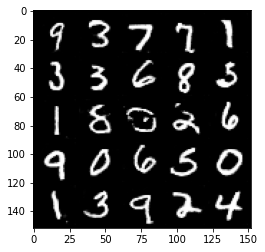

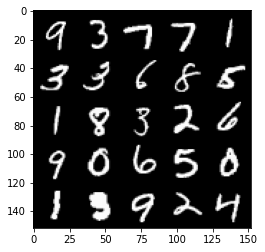

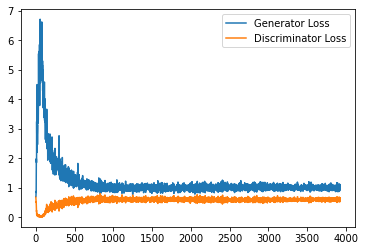

Step 79000: Generator loss: 0.9926150252819061, discriminator loss: 0.601558522939682


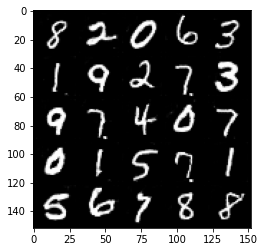

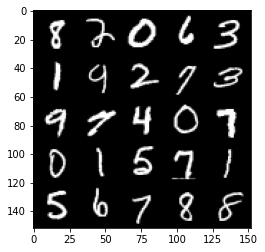

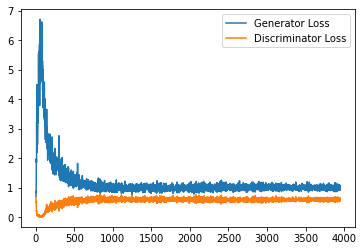

Step 79500: Generator loss: 0.9870986729860306, discriminator loss: 0.6008340845704079


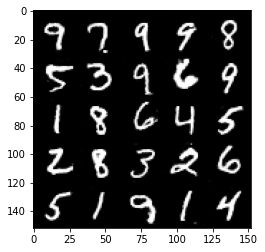

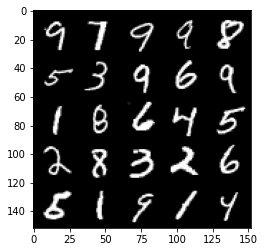

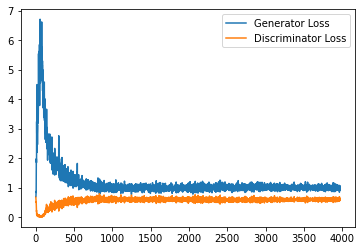

Step 80000: Generator loss: 0.9891111166477203, discriminator loss: 0.6024659104943275


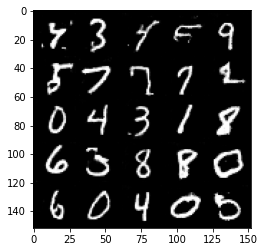

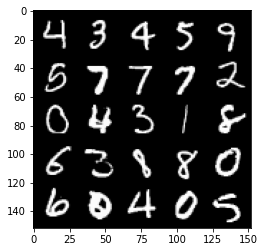

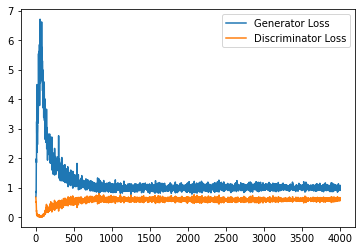

Step 80500: Generator loss: 1.0043179478645325, discriminator loss: 0.6029612273573876


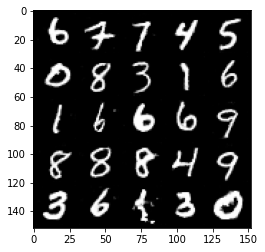

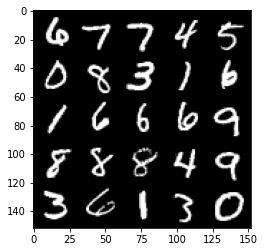

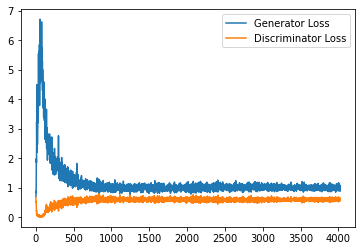

Step 81000: Generator loss: 0.9903369327783584, discriminator loss: 0.6037731987833976


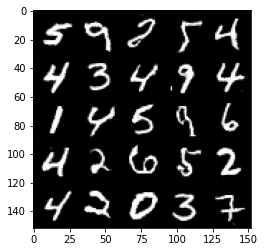

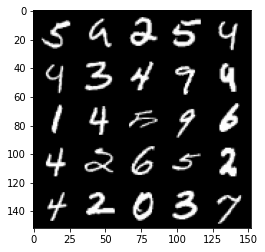

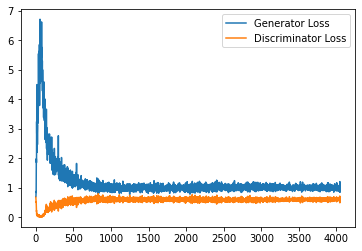

Step 81500: Generator loss: 1.0109251602888107, discriminator loss: 0.6003489434123039


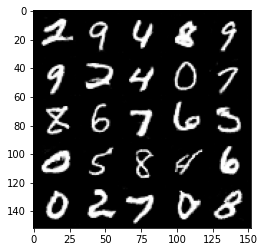

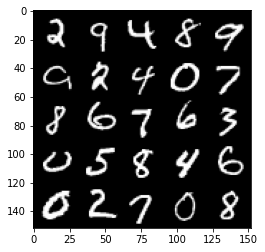

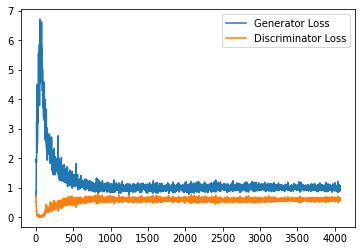

Step 82000: Generator loss: 0.9701628919839859, discriminator loss: 0.6035592195987701


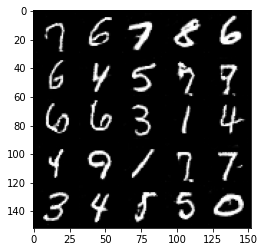

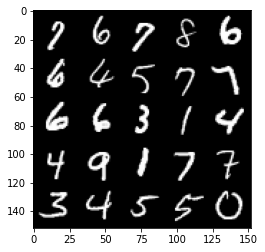

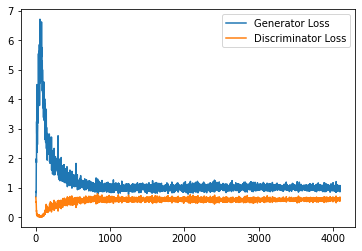

Step 82500: Generator loss: 1.0011727594137192, discriminator loss: 0.6027975456118584


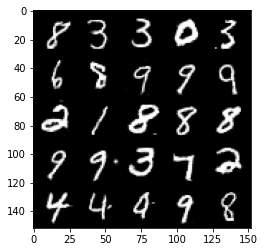

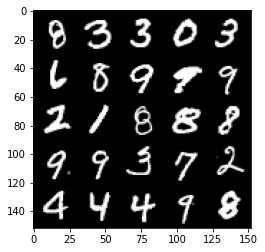

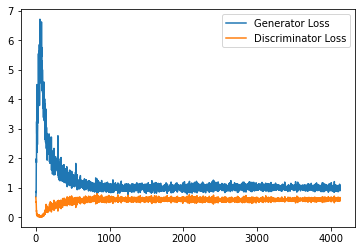

Step 83000: Generator loss: 0.9764634211063385, discriminator loss: 0.6070248591899872


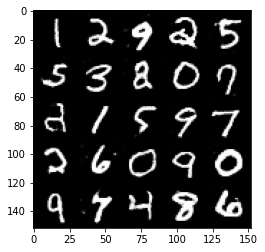

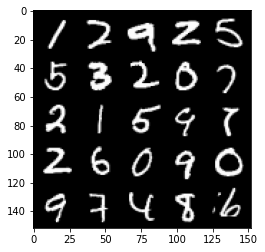

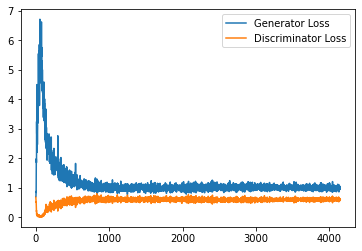

Step 83500: Generator loss: 1.0112830917835236, discriminator loss: 0.6011067587733269


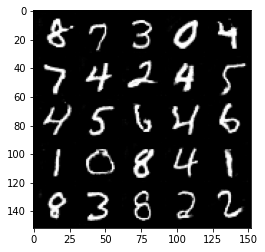

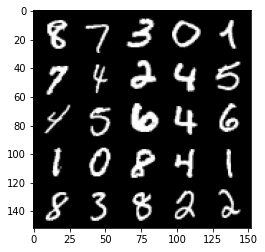

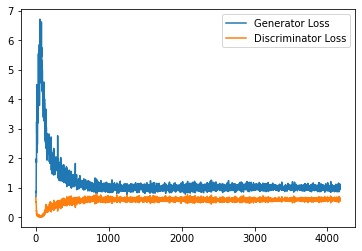

Step 84000: Generator loss: 0.9866035374402999, discriminator loss: 0.6086361081600189


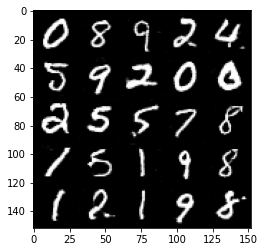

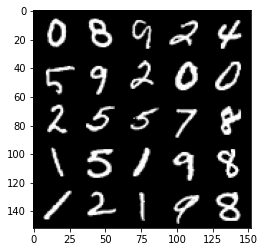

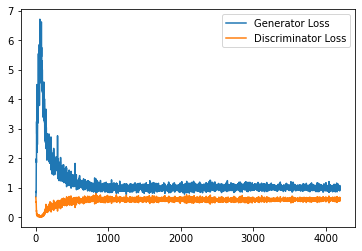

Step 84500: Generator loss: 1.0005429581403733, discriminator loss: 0.6020062595605851


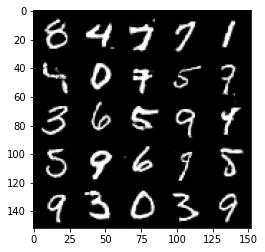

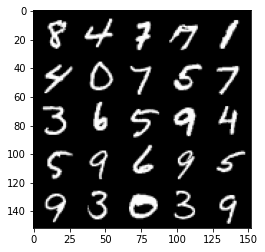

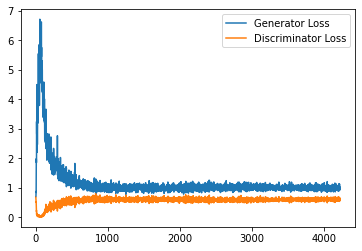

Step 85000: Generator loss: 0.9868877638578415, discriminator loss: 0.6069023576378823


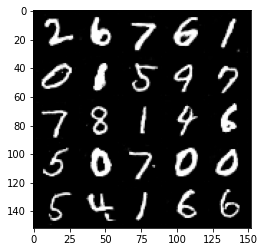

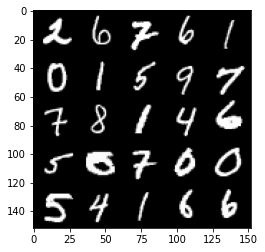

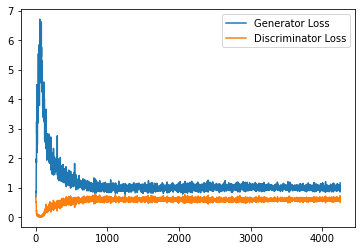

Step 85500: Generator loss: 0.9830826046466827, discriminator loss: 0.6098034216761589


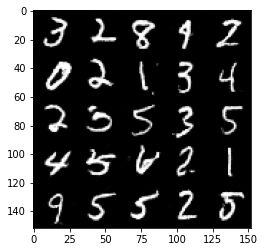

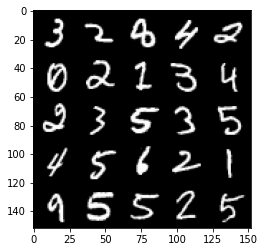

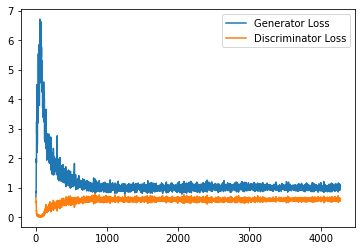

Step 86000: Generator loss: 0.9888391493558883, discriminator loss: 0.609394227027893


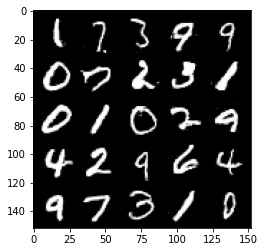

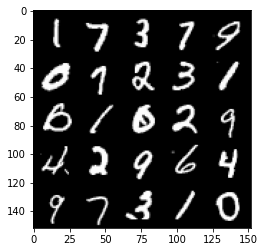

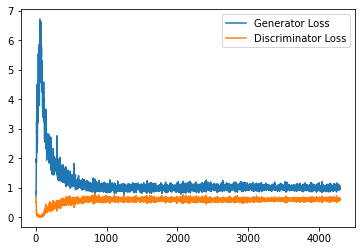

Step 86500: Generator loss: 0.9897198315858841, discriminator loss: 0.6047340587377549


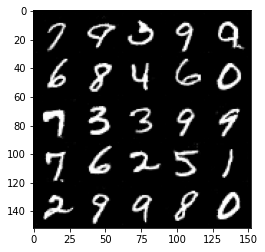

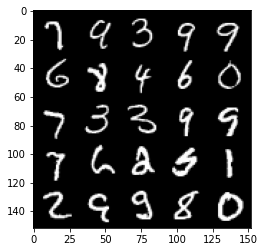

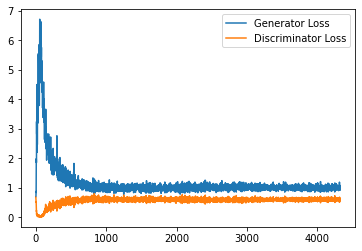

Step 87000: Generator loss: 0.9952927144765854, discriminator loss: 0.6089575107097626


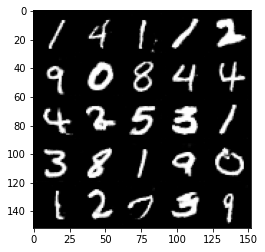

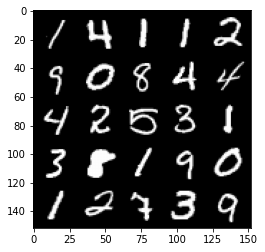

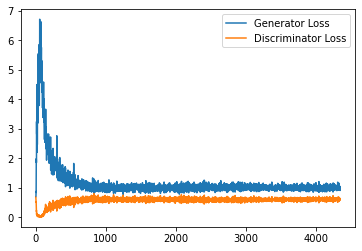

Step 87500: Generator loss: 0.9650033406019211, discriminator loss: 0.6107842084169388


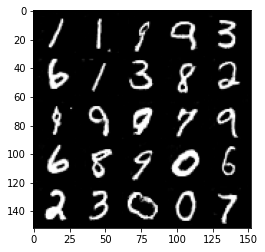

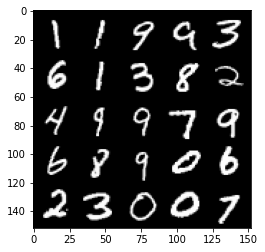

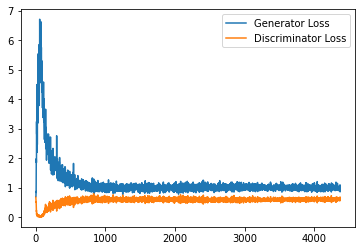

Step 88000: Generator loss: 0.9826945666074752, discriminator loss: 0.6125543726086616


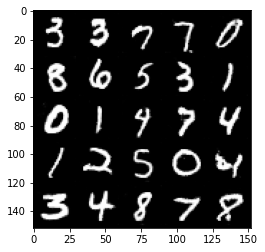

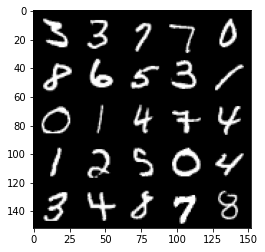

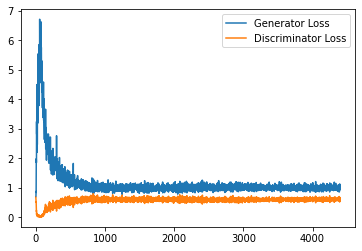

Step 88500: Generator loss: 0.9672318532466888, discriminator loss: 0.608244355738163


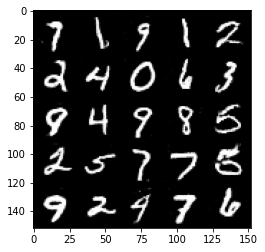

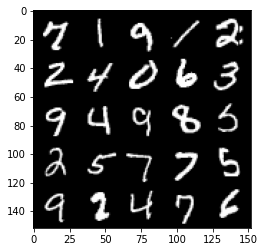

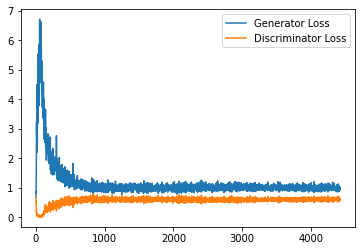

Step 89000: Generator loss: 0.9818884582519531, discriminator loss: 0.6130908534526825


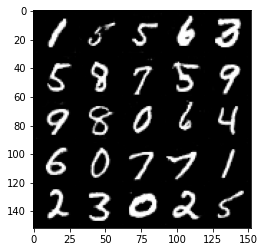

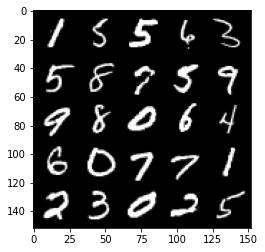

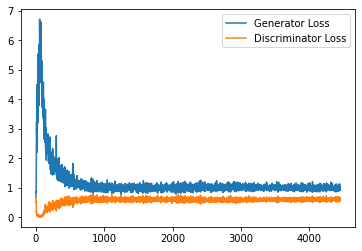

Step 89500: Generator loss: 0.9608325245380401, discriminator loss: 0.6147372613549232


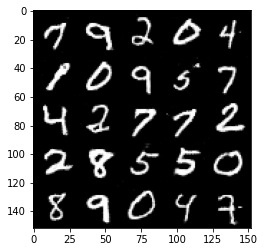

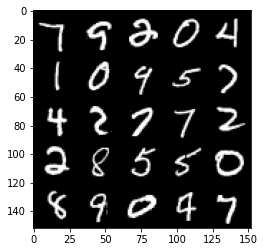

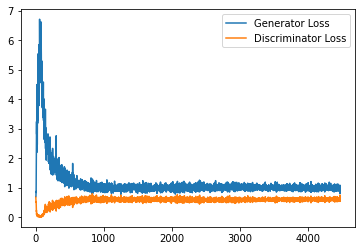

Step 90000: Generator loss: 1.020302519917488, discriminator loss: 0.6059385784864426


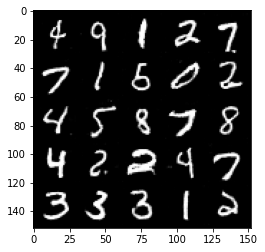

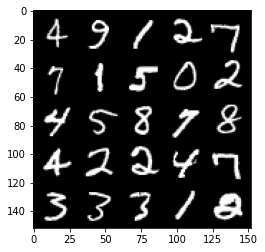

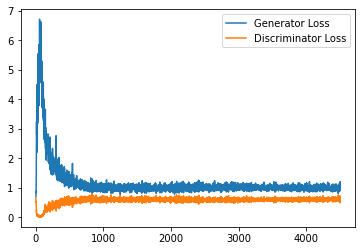

Step 90500: Generator loss: 0.9650965851545333, discriminator loss: 0.6180638720393181


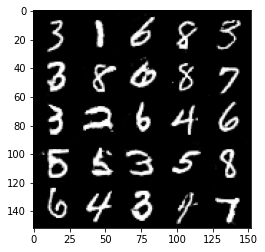

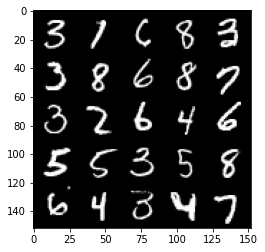

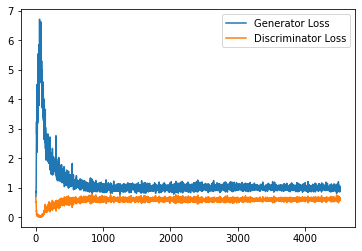

Step 91000: Generator loss: 0.9677364157438278, discriminator loss: 0.6154474180936813


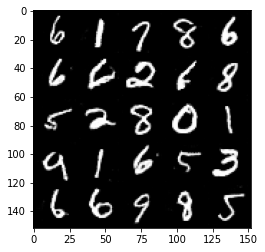

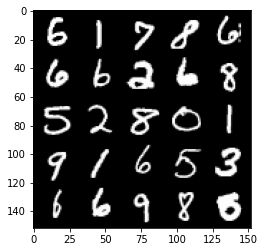

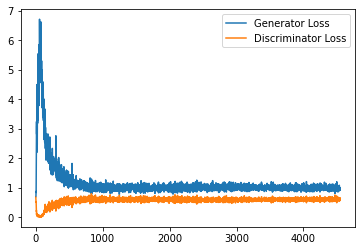

Step 91500: Generator loss: 0.9903305971622467, discriminator loss: 0.6113105090856552


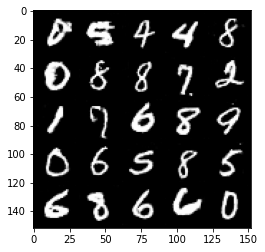

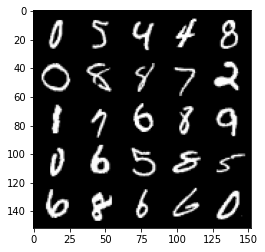

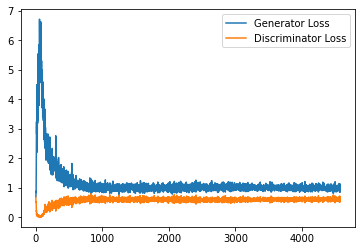

Step 92000: Generator loss: 0.9838190943598747, discriminator loss: 0.6142423053979874


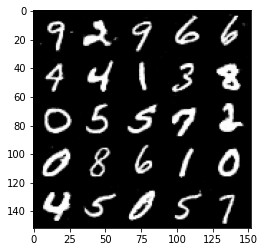

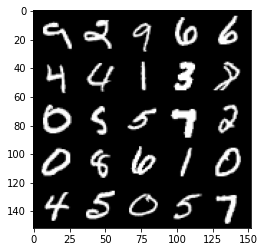

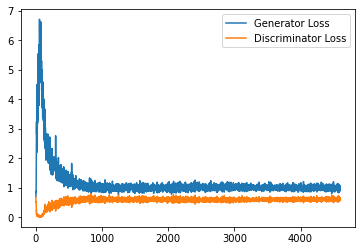

Step 92500: Generator loss: 0.9713943883180618, discriminator loss: 0.6117143098711968


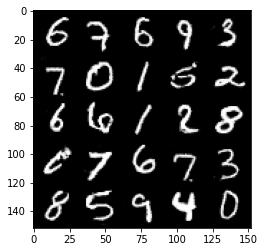

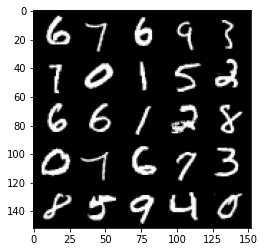

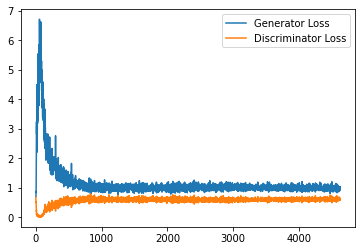

Step 93000: Generator loss: 0.9754478536844253, discriminator loss: 0.613939954996109


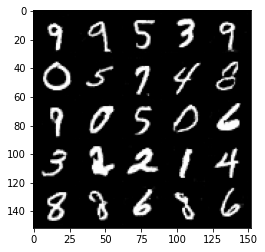

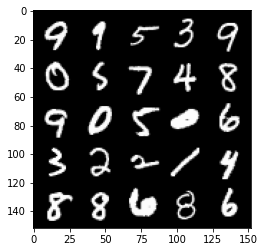

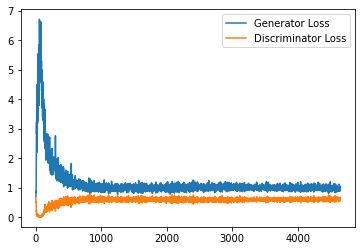

Step 93500: Generator loss: 0.9819821397066116, discriminator loss: 0.6128341529369354


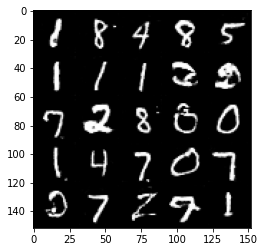

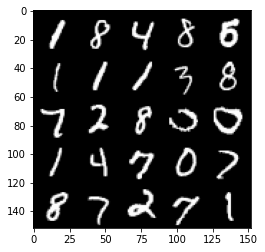

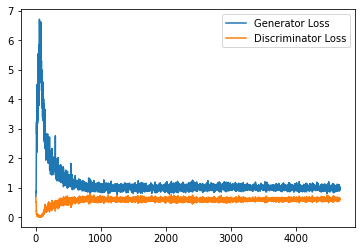

In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()